In [1]:
!pip install nltk wordcloud  scikit-learn

In [2]:
import string, os, nltk, re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
from PIL import Image
from wordcloud import WordCloud
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.datasets import load_digits
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics.pairwise import cosine_similarity



nltk.download('punkt')
nltk.download('stopwords')
nltk.download('punkt_tab')
nltk.download('wordnet')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\lamif\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\lamif\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\lamif\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\lamif\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

# **WORD CLOUD**

#### Read files

In [3]:
# books_folder = 'Data_NLP'
# total_files = len(os.listdir(books_folder))
# print(f"Il y a {total_files} fichiers dans le dossier.")

# for filename in os.listdir(books_folder):
#     file_path = os.path.join(books_folder, filename)
#     with open(file_path, "r", encoding="utf-8") as file:
#             content = file.read()
#             num_words = len(content.split())
#             print(f"Le fichier {filename} contient {num_words} mots.")
#             print("**")

books_folder = 'Data - NLP'
list_books = []
total_files = len(os.listdir(books_folder))
print(f"Il y a {total_files} fichiers dans le dossier.")

for filename in os.listdir(books_folder):
        with open(os.path.join(books_folder, filename), 'r', encoding='utf-8') as file:
            content = file.read()
            list_books.append(content)

            num_words = len(content.split())
            print(f"Le fichier {filename} contient {num_words} mots.")
            print("**")

Il y a 52 fichiers dans le dossier.
Le fichier alice-in-wonderland.txt contient 17842 mots.
**
Le fichier Among the Forest People.txt contient 34418 mots.
**
Le fichier An Introductory Course of Quantitative Chemical Analysis.txt contient 67466 mots.
**
Le fichier Curious Myths of the Middle Ages.txt contient 52870 mots.
**
Le fichier Democracy In America, Volume 1 (of 2).txt contient 193515 mots.
**
Le fichier Experiments and Observations on Different.txt contient 78564 mots.
**
Le fichier Formation of the Union, 1750-1829.txt contient 81799 mots.
**
Le fichier Histories of two hundred and fifty-one divisions of the German army which participated in the wa.txt contient 299830 mots.
**
Le fichier History of King Charles The First of England.txt contient 57041 mots.
**
Le fichier History of Phosphorus.txt contient 13522 mots.
**
Le fichier How the Flag Became Old Glory.txt contient 25876 mots.
**
Le fichier Little Lord Fauntleroy.txt contient 61352 mots.
**
Le fichier Medieval People.tx

#### Tokenisation

    La tokenisation en Traitement Automatique du Langage Naturel est le processus de découpage d'un texte en unités plus petites appelées "tokens".

    Découpage: Le texte est divisé en unités individuelles, qui peuvent être des mots, des phrases, ou même des caractères individuels.
    Raisonnement: Cette étape est cruciale car elle permet de transformer le texte brut en une forme que les algorithmes de NLP peuvent comprendre et traiter.
    En effet, les algorithmes ne peuvent pas directement interpréter du texte brut.
    Ils ont besoin d'unités plus petites et plus structurées pour effectuer des analyses.


In [4]:
# def tokeniz(text):
#     tokens = word_tokenize(text)
#     tokens = text.lower()
#     tokens = re.sub( r'[^A-Za-z\s\w\d+]+' , '' , text)
#     stop_words = set(stopwords.words('english'))
#     tokens = [word for word in tokens if word not in stop_words]
#     return tokens

# tokenized_books = [tokeniz(book) for book in list_books]

def tokeniz(text):
    text = text.lower()
    text = re.sub(r'[^a-zA-Z0-9\s]', '', text)
    tokens = word_tokenize(text)
    tokens = [token for token in tokens if token.isalpha()]
    stop_words = set(stopwords.words('english'))
    tokens = [word for word in tokens if word not in stop_words]
    return tokens

tokenized_books = [tokeniz(book) for book in list_books]


    #   # Supprimer les caractères non alphanumériques
    # tokens = text.split()
    # tokens = [token for token in tokens if token.isalpha()]
    # return " ".join(filtered_tokens)
#print result tokeniz
# print(tokenized_books)




# def tokeniz(text):
#     tokens = word_tokenize(text)
#     new_tokens = []
#     for word in tokens:
#         if word.isalpha():
#             new_tokens.append(word.lower())
#     stop_words = set(stopwords.words('english'))
#     filtered_tokens = [word for word in new_tokens if word not in stop_words]
#     return filtered_tokens

# # Apply the preprocessing (tokenization)
# tokenized_books = [tokeniz(book) for book in preprocessed_books]

In [5]:
#afficher le contenu de chaque ficher tokenizer

for i, book_file in enumerate(tokenized_books):
  filename = os.listdir(books_folder)[i]
  print(f'le contenu tokenisé du livre {filename} est : {book_file}')
  print("*****************************************************************************************\n")

le contenu tokenisé du livre alice-in-wonderland.txt est : ['project', 'gutenberg', 'ebook', 'alice', 'wonderland', 'alice', 'gerstenberg', 'ebook', 'use', 'anyone', 'anywhere', 'cost', 'almost', 'restrictions', 'whatsoever', 'may', 'copy', 'give', 'away', 'reuse', 'terms', 'project', 'gutenberg', 'license', 'included', 'ebook', 'online', 'wwwgutenbergorg', 'title', 'alice', 'wonderland', 'dramatization', 'lewis', 'carrolls', 'alices', 'adventures', 'wonderland', 'looking', 'glass', 'author', 'alice', 'gerstenberg', 'release', 'date', 'march', 'ebook', 'language', 'english', 'start', 'project', 'gutenberg', 'ebook', 'alice', 'wonderland', 'produced', 'online', 'distributed', 'proofreading', 'team', 'httpswwwpgdpnet', 'file', 'produced', 'images', 'generously', 'made', 'available', 'internet', 'archive', 'illustration', 'illustration', 'alice', 'youre', 'humpty', 'dumpty', 'like', 'egg', 'page', 'alice', 'wonderland', 'dramatization', 'lewis', 'carrolls', 'alices', 'adventures', 'wonder

#### Lemmatisation

  La lemmatisation est une technique de traitement du langage naturel (NLP) qui consiste à réduire un mot à sa forme canonique, appelée lemme. Le lemme est la forme de base d'un mot, telle qu'elle est généralement trouvée dans un dictionnaire.

    Voici un exemple :

    Le mot "better" est lemmatisé en "good".
    Les mots "studies", "studying" et "studied" sont lemmatisés en "study".


In [6]:
#lemmatize du "tokens" créé après la tokenisation
lemmatizer = WordNetLemmatizer()
def lemmatize(tokens):
    return [lemmatizer.lemmatize(token) for token in tokens]

# emmatisation
lemmatized_books = [lemmatize(tokens) for tokens in tokenized_books]

In [7]:
#comparaison du contenu tokeniser et la lemmatisation
for i in tokenized_books :
  print(len(i))
print("*********")
for y in lemmatized_books :
  print(len(y))

9572
15796
34146
25761
90649
37006
42906
132920
26871
7286
13927
28884
43864
13360
182741
28464
6347
10009
14176
49474
138964
21346
6917
19440
47051
165818
24996
121544
33676
112590
811673
42394
3524
21080
45672
54156
24609
76959
31343
16367
48688
41055
2396
21610
29276
55925
23606
10788
15961
22759
17565
275177
*********
9572
15796
34146
25761
90649
37006
42906
132920
26871
7286
13927
28884
43864
13360
182741
28464
6347
10009
14176
49474
138964
21346
6917
19440
47051
165818
24996
121544
33676
112590
811673
42394
3524
21080
45672
54156
24609
76959
31343
16367
48688
41055
2396
21610
29276
55925
23606
10788
15961
22759
17565
275177


In [8]:
# #display bag_of_word
# term_freq = []
# for book in lemmatized_books:
#     term_freq.append(Counter(book))

# for i, book_files in enumerate(lemmatized_books):
#   filename = os.listdir(books_folder)[i]
#   print(f'le contenu du livre {filename} est : {term_freq}')

#### Terms Frequency && word cloud

Fréquence des termes (TF) représente le nombre de fois qu'un terme spécifique apparaît dans un document donné.

In [8]:
#frequency
term_freq = []
for book in lemmatized_books:
    term_freq.append(Counter(book))

#top20
for i, book_freq in enumerate(term_freq):
    filename = os.listdir(books_folder)[i]
    print("*****************************************************************************************\n")
    print(f'Top 20 termes pour le Livre {filename}')
    top_20 = book_freq.most_common(20)
    df_top_20 = pd.DataFrame(top_20, columns=['Term', 'Frequency'])
    print(df_top_20)

*****************************************************************************************

Top 20 termes pour le Livre alice-in-wonderland.txt
           Term  Frequency
0         alice        388
1         queen        188
2         white         97
3       project         87
4          know         85
5          work         83
6          king         75
7          dont         72
8           one         65
9           red         64
10           go         58
11       hatter         57
12           oh         57
13         like         56
14       turtle         56
15  gutenbergtm         56
16      duchess         54
17         mock         53
18        would         51
19        thing         50
*****************************************************************************************

Top 20 termes pour le Livre Among the Forest People.txt
       Term  Frequency
0      said        252
1     would        178
2       one        165
3        mr        128
4     could        120
5    

un nuage de mots est une représentation visuelle de la fréquence des mots dans un texte.



Top 20 termes pour le Livre alice-in-wonderland.txt
           Term  Frequency
0         alice        388
1         queen        188
2         white         97
3       project         87
4          know         85
5          work         83
6          king         75
7          dont         72
8           one         65
9           red         64
10           go         58
11       hatter         57
12           oh         57
13         like         56
14       turtle         56
15  gutenbergtm         56
16      duchess         54
17         mock         53
18        would         51
19        thing         50


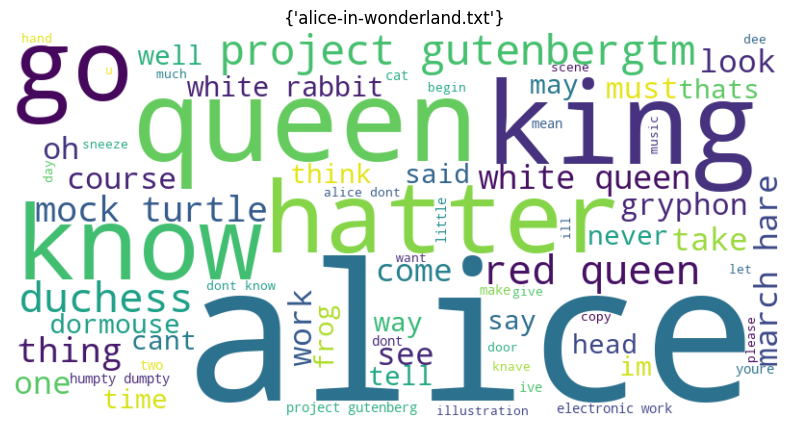

Top 20 termes pour le Livre Among the Forest People.txt
       Term  Frequency
0      said        252
1     would        178
2       one        165
3        mr        128
4     could        120
5       see        119
6    little        112
7    ground        104
8    forest        100
9      work        100
10   people         93
11     know         92
12  project         87
13    never         87
14    great         82
15     time         82
16    young         78
17   rabbit         76
18      hog         75
19  thought         74


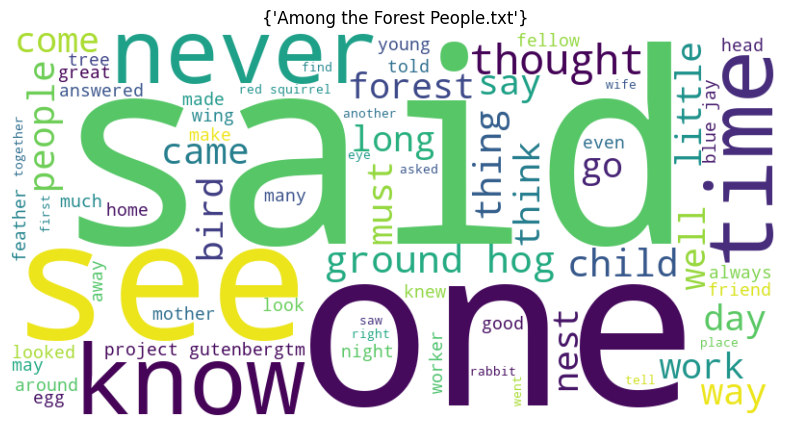

Top 20 termes pour le Livre An Introductory Course of Quantitative Chemical Analysis.txt
             Term  Frequency
0        solution        959
1            acid        723
2              cc        451
3            note        356
4            gram        324
5           water        286
6          weight        274
7             may        257
8     precipitate        214
9            iron        186
10         filter        175
11       analysis        169
12            ion        163
13           must        163
14       chloride        161
15         sodium        151
16           used        149
17   hydrochloric        144
18  determination        140
19       crucible        135


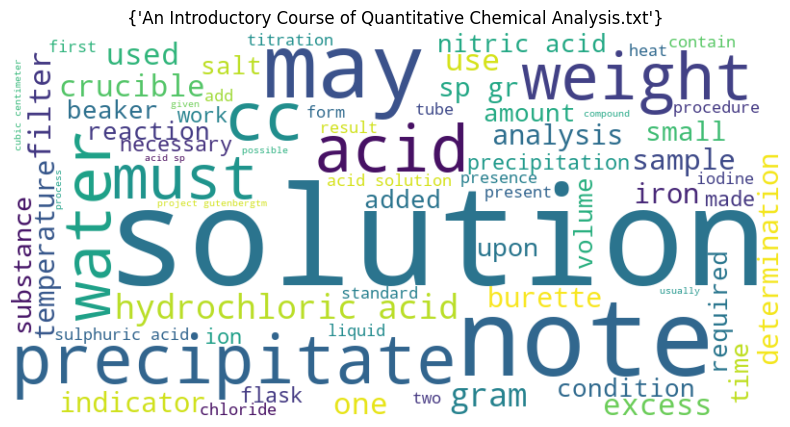

Top 20 termes pour le Livre Curious Myths of the Middle Ages.txt
       Term  Frequency
0       one        155
1       man        150
2       rod        116
3      year        105
4      work        105
5       day         93
6     story         92
7      king         91
8       may         88
9   project         87
10     upon         77
11       de         76
12     time         73
13   number         70
14    place         68
15     name         68
16     moon         66
17    water         66
18     also         64
19     john         63


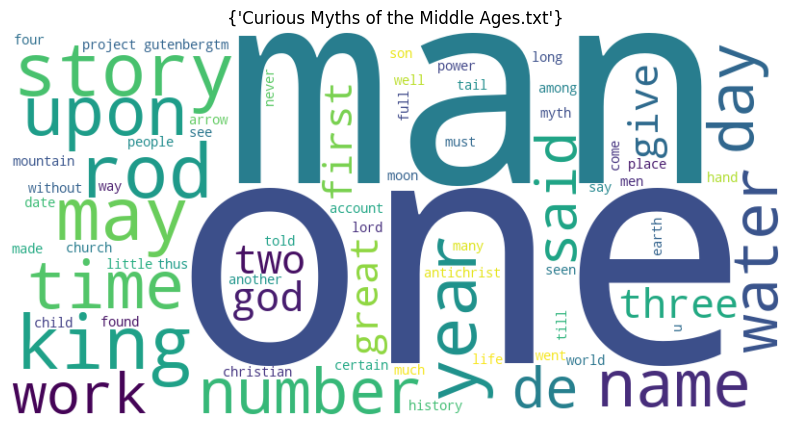

Top 20 termes pour le Livre Democracy In America, Volume 1 (of 2).txt
          Term  Frequency
0        state       1442
1          may        645
2          law        637
3         upon        623
4        power        623
5   government        617
6       united        563
7       people        549
8     american        537
9       nation        455
10     country        439
11         one        438
12       union        433
13     america        381
14       would        378
15       great        369
16        time        351
17     without        342
18   authority        331
19      public        322


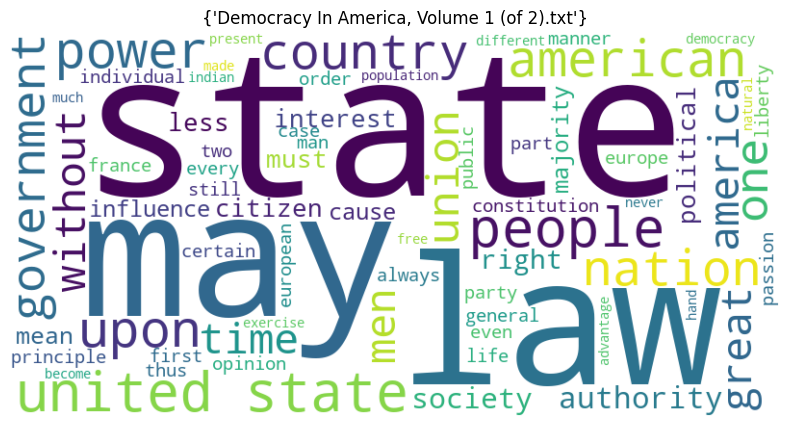

Top 20 termes pour le Livre Experiments and Observations on Different.txt
           Term  Frequency
0           air       2069
1         water        611
2        common        325
3         fixed        310
4      quantity        309
5       nitrous        297
6          made        291
7    experiment        276
8           one        246
9           may        244
10         kind        242
11  inflammable        233
12         time        220
13         acid        207
14         much        199
15         also        180
16         part        178
17   phlogiston        166
18         upon        161
19        found        155


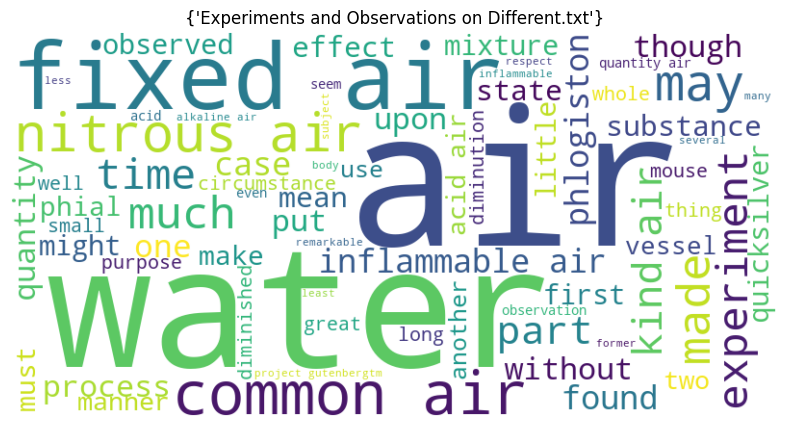

Top 20 termes pour le Livre Formation of the Union, 1750-1829.txt
            Term  Frequency
0          state        652
1       sidenote        589
2            new        355
3     government        353
4       american        345
5         colony        310
6       congress        283
7            war        266
8         united        263
9        england        227
10           act        197
11         power        188
12       english        173
13       british        173
14          time        168
15  constitution        168
16           one        165
17          made        162
18         first        151
19           two        146


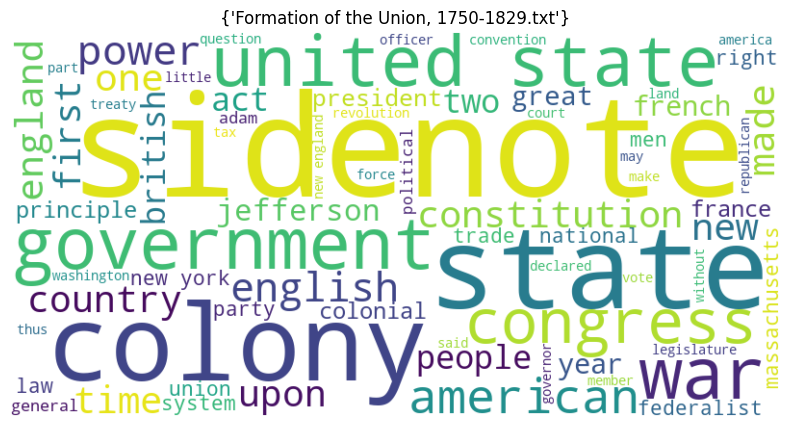

Top 20 termes pour le Livre Histories of two hundred and fifty-one divisions of the German army which participated in the wa.txt
        Term  Frequency
0   division       6400
1         re       2830
2         co       2604
3   regiment       2182
4        rgt       1936
5       pion       1880
6    reserve       1650
7     sector       1476
8        bav       1371
9      front       1291
10      line       1265
11  hospital       1222
12  infantry       1131
13         f       1101
14   october       1071
15       btn       1067
16  relieved       1029
17     field       1012
18       ldw        965
19     detch        959


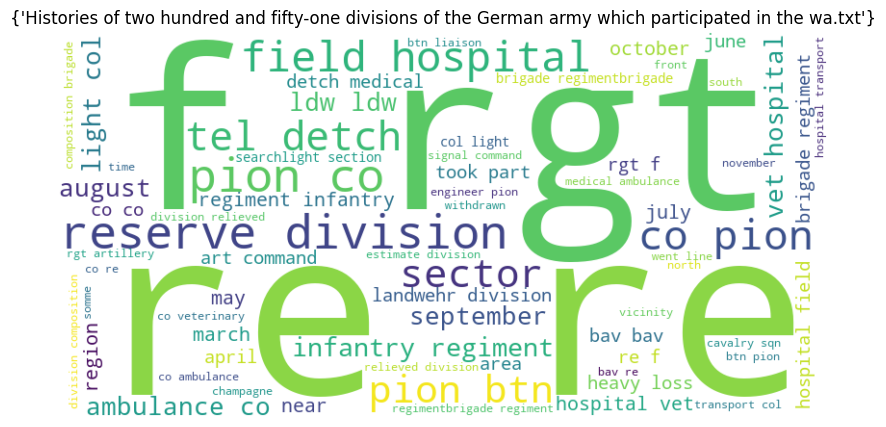

Top 20 termes pour le Livre History of King Charles The First of England.txt
          Term  Frequency
0         king        723
1     sidenote        481
2   parliament        215
3        would        200
4          one        176
5        great        176
6         time        159
7      charles        158
8        house        150
9       called        118
10         day        114
11        said        111
12       could        111
13        made        108
14     england        105
15       power        105
16        upon        104
17      common         98
18      people         97
19       court         95


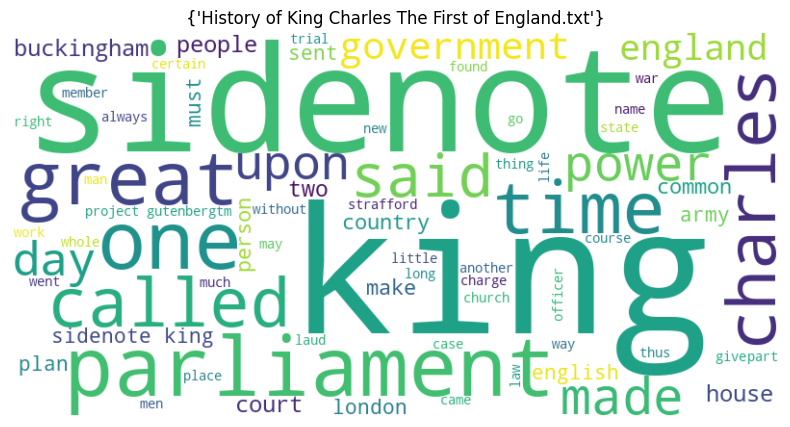

Top 20 termes pour le Livre History of Phosphorus.txt
            Term  Frequency
0           acid        114
1           work         94
2        project         87
3     phosphorus         81
4      phosphate         72
5    gutenbergtm         56
6          state         40
7     phosphoric         40
8              p         40
9             de         37
10           vol         32
11     substance         31
12           new         31
13     gutenberg         30
14      chemical         28
15        united         27
16  illustration         27
17    electronic         27
18          page         25
19         plant         25


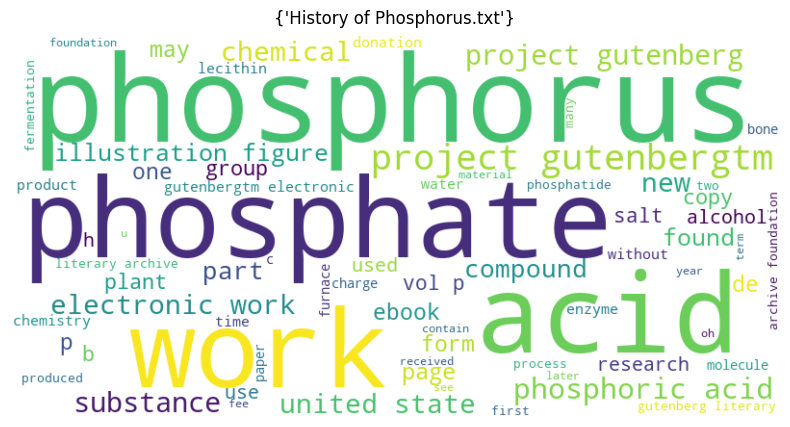

Top 20 termes pour le Livre How the Flag Became Old Glory.txt
           Term  Frequency
0          flag        111
1           old         94
2       general         89
3       project         88
4          work         85
5           one         75
6          upon         68
7           day         65
8         glory         63
9   gutenbergtm         56
10          men         48
11          war         47
12        state         45
13      british         45
14         fort         44
15         like         44
16       battle         44
17     american         43
18         ship         42
19          new         40


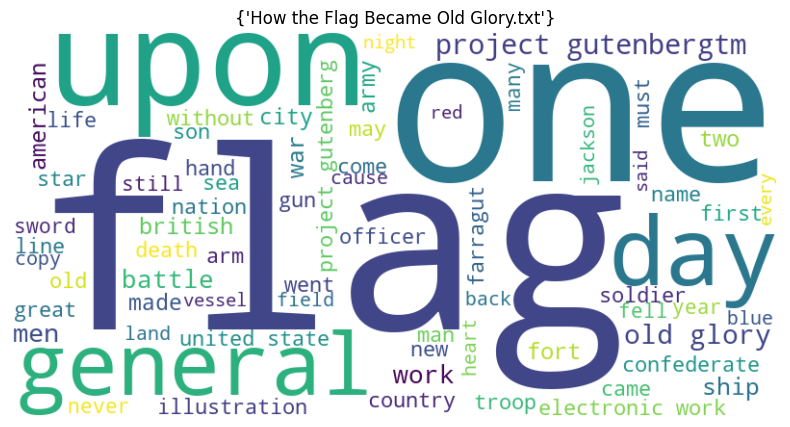

Top 20 termes pour le Livre Little Lord Fauntleroy.txt
          Term  Frequency
0         said        473
1           mr        394
2         earl        387
3       little        344
4   fauntleroy        274
5          one        258
6        would        249
7         lord        191
8          boy        191
9          see        159
10        like        153
11       hobbs        152
12      cedric        150
13      looked        143
14        know        143
15         old        140
16    havisham        136
17       could        134
18       great        130
19       quite        126


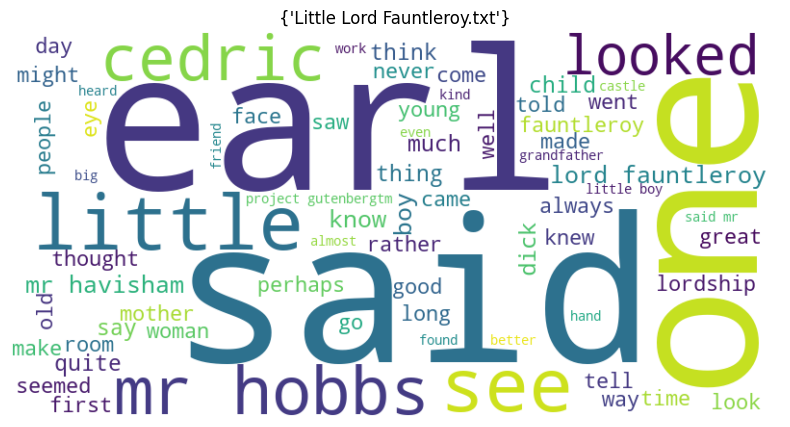

Top 20 termes pour le Livre Medieval People.txt
        Term  Frequency
0        one        237
1        see        208
2      great        205
3     thomas        176
4       work        173
5      house        170
6      would        163
7        day        157
8       year        145
9       good        134
10         p        134
11      upon        133
12  merchant        132
13      also        132
14      wool        131
15       may        130
16      time        126
17      wife        124
18      book        115
19      must        114


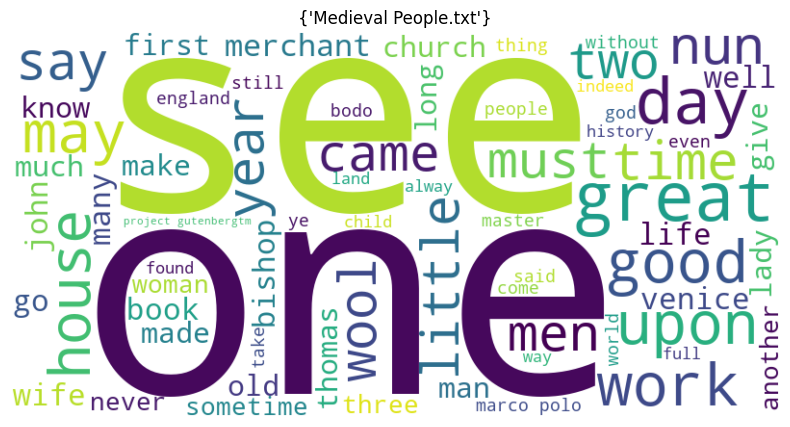

Top 20 termes pour le Livre Mother Storie.txt
       Term  Frequency
0    little        235
1      said        144
2    mother        132
3      work        122
4       one         94
5      home         92
6   project         87
7      came         83
8      king         79
9     child         73
10      see         71
11     good         68
12    could         68
13     away         67
14      day         66
15      saw         65
16    would         64
17    great         61
18    fairy         60
19     made         60


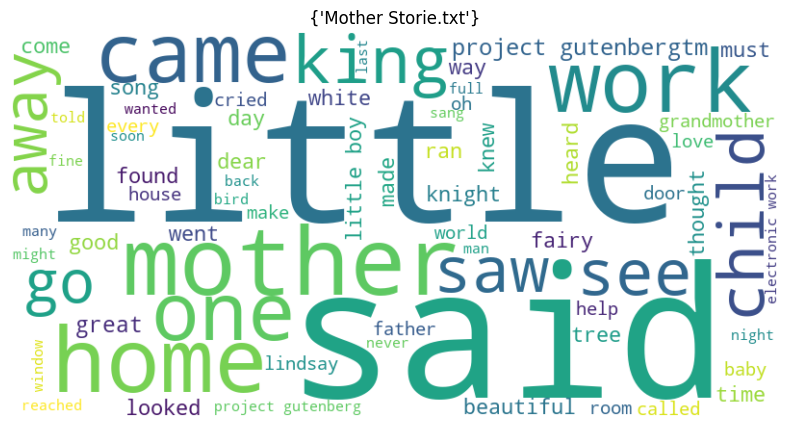

Top 20 termes pour le Livre Narrative and Critical History of America.txt
        Term  Frequency
0         de       2663
1          p       1373
2    america        821
3        vol        777
4     indian        750
5         ii        719
6         la        715
7         cf        689
8   american        647
9        one        613
10       map        595
11      work        546
12       new        534
13       man        534
14      also        529
15      made        522
16      amer        512
17        le        501
18     found        500
19         j        495


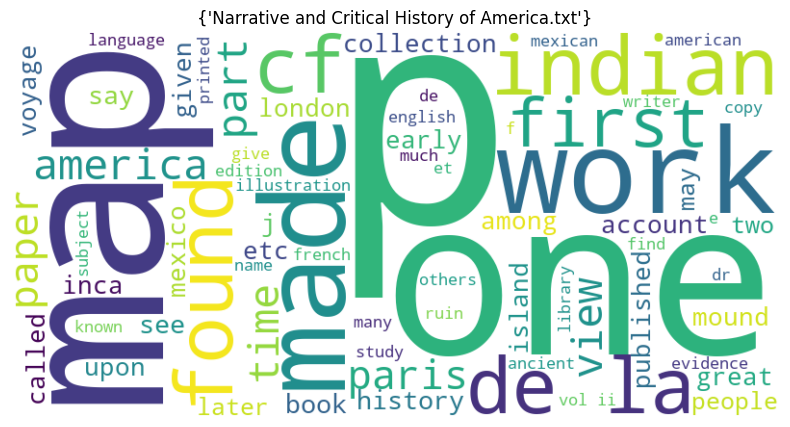

Top 20 termes pour le Livre O Pioneers.txt
         Term  Frequency
0   alexandra        387
1        emil        277
2        like        217
3         one        202
4       could        154
5       marie        152
6      little        151
7        carl        151
8       would        147
9         old        146
10        boy        145
11         go        142
12        see        132
13      thing        131
14      frank        131
15       work        128
16       said        126
17       come        125
18       back        125
19       went        117


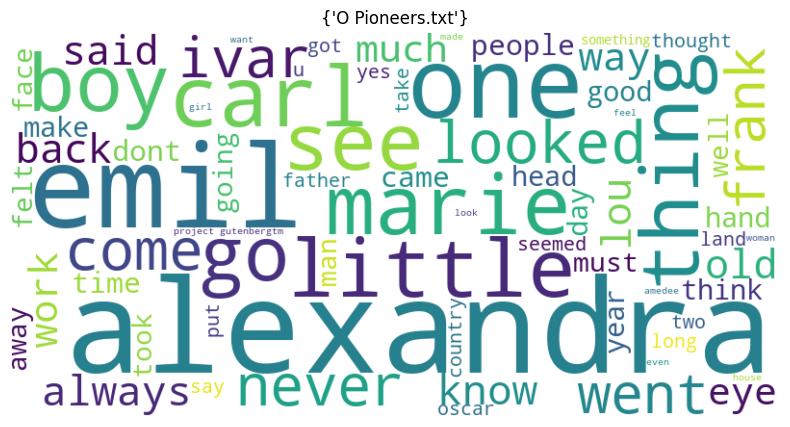

Top 20 termes pour le Livre Peter-pan.txt
            Term  Frequency
0          peter        100
1        project         87
2           work         78
3          wendy         77
4            boy         74
5    gutenbergtm         56
6         little         48
7            one         46
8         pirate         41
9        darling         41
10            mr         37
11         child         34
12          hook         34
13         would         31
14     gutenberg         30
15         fairy         27
16          like         27
17    electronic         27
18  illustration         26
19       captain         26


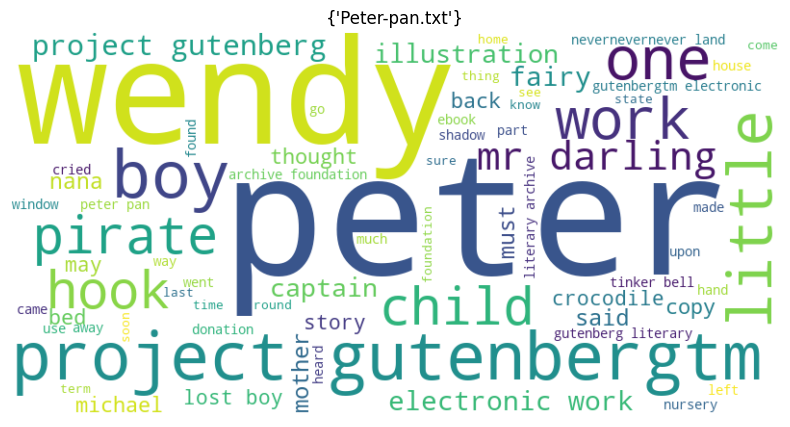

Top 20 termes pour le Livre Prince Prigio.txt
            Term  Frequency
0         prince        241
1           said        145
2           king         99
3         prigio         93
4      firedrake         89
5        project         87
6           work         83
7           lady         60
8    gutenbergtm         56
9          would         54
10          like         51
11         could         45
12         never         44
13         fairy         43
14  illustration         41
15       chapter         39
16           one         39
17          went         36
18          back         36
19         queen         34


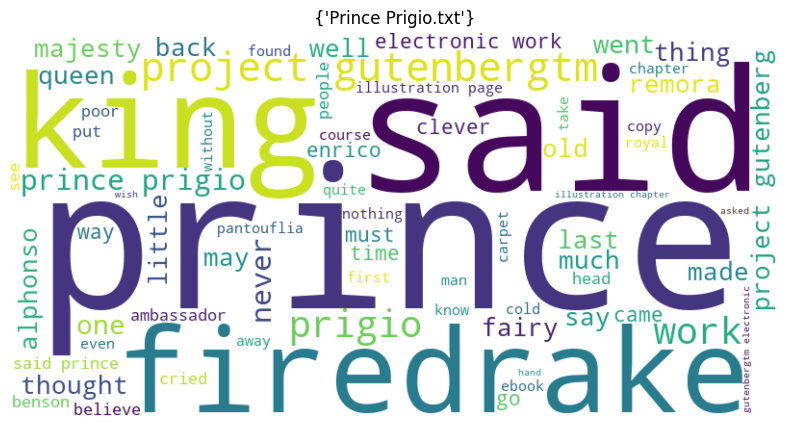

Top 20 termes pour le Livre Sandman_s Goodnight Stories.txt
       Term  Frequency
0      said        297
1        mr        277
2    little        212
3       one        130
4     would        125
5     fairy        119
6    goblin         94
7      work         94
8     could         88
9   project         87
10     know         83
11      see         75
12      old         69
13     tell         68
14     time         68
15  thought         68
16     told         65
17       oh         65
18    never         65
19     jack         64


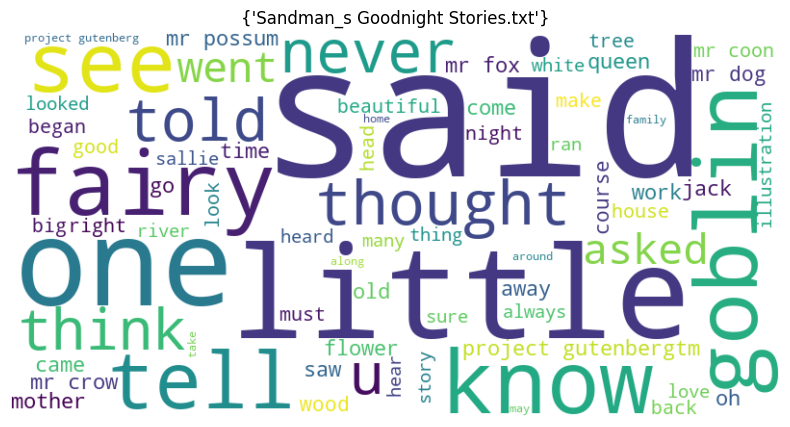

Top 20 termes pour le Livre The Chemistry of Cookery.txt
           Term  Frequency
0         water        500
1           may        386
2          food        288
3          meat        221
4          acid        207
5           one        197
6          work        189
7           fat        177
8          thus        171
9          wine        168
10  temperature        162
11      cookery        161
12     quantity        161
13         made        160
14      boiling        157
15       cheese        156
16       little        152
17         upon        143
18        juice        130
19         much        129


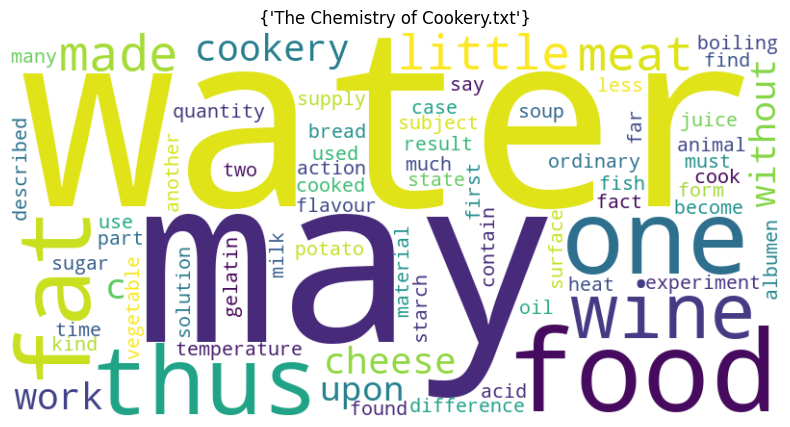

Top 20 termes pour le Livre The Complete Herbal.txt
      Term  Frequency
0     help       1266
1     leaf       1159
2     take       1090
3     root       1045
4     dram        960
5    ounce        950
6     seed        909
7   flower        903
8     also        886
9      two        852
10    herb        808
11    half        796
12   water        794
13     one        783
14   white        753
15    good        749
16   place        672
17    time        647
18   juice        645
19     may        631


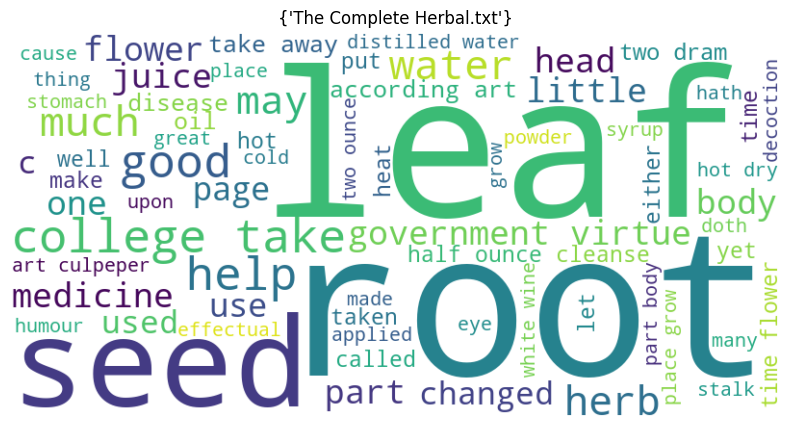

Top 20 termes pour le Livre The Eighteenth Brumaire of Louis Bonaparte.txt
             Term  Frequency
0           order        211
1        national        190
2       bonaparte        183
3           party        176
4        assembly        173
5           class        127
6            upon        121
7           power        116
8             one        107
9       bourgeois        106
10    bourgeoisie        106
11           work         98
12        society         94
13  parliamentary         93
14       republic         91
15            may         89
16        project         88
17       december         87
18         french         81
19   constitution         75


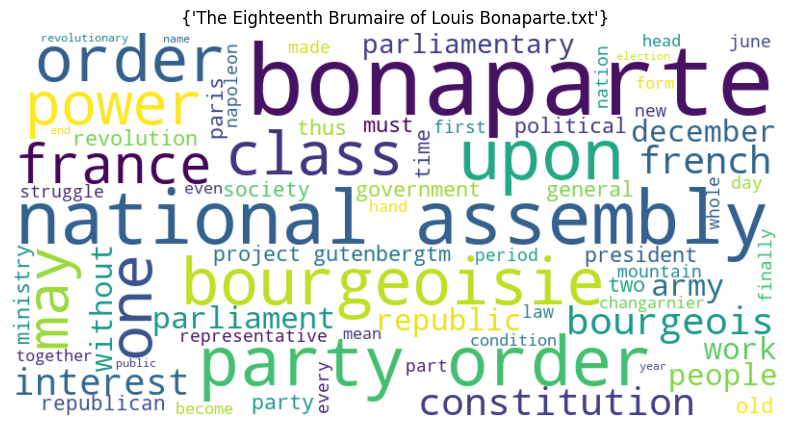

Top 20 termes pour le Livre The Elements of Blowpipe Analysis.txt
           Term  Frequency
0            ch        137
1            bp        117
2         color        114
3         flame         92
4       project         87
5     colorless         86
6          work         83
7          tube         78
8          bead         69
9      ignition         67
10     metallic         57
11  gutenbergtm         56
12            g         50
13     platinum         48
14         wire         48
15        borax         46
16    substance         45
17      reduced         42
18       lustre         39
19            f         34


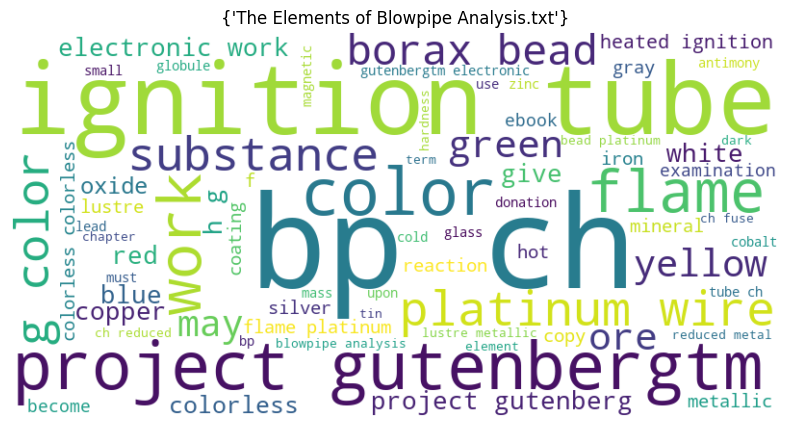

Top 20 termes pour le Livre The fauna of the deep sea.txt
       Term  Frequency
0     water        216
1   deepsea        191
2     depth        186
3    fathom        165
4      form        159
5     fauna        152
6    animal        149
7      deep        141
8       one        132
9       sea        130
10      may        126
11   specie        124
12    genus        114
13     many        112
14    found        112
15     work        106
16     fish        106
17      eye        103
18    great         91
19  abysmal         90


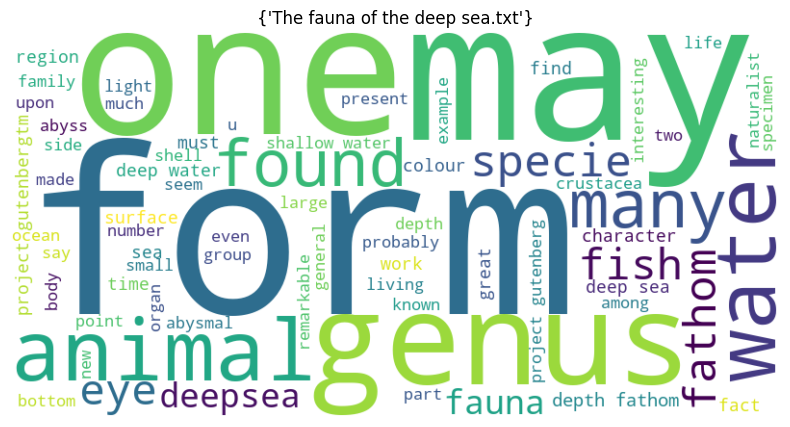

Top 20 termes pour le Livre The Foundations of the Origin of Species.txt
         Term  Frequency
0           p        686
1      specie        650
2      origin        439
3         one        387
4          ed        380
5       would        362
6          vi        312
7         see        283
8      animal        282
9        case        282
10       form        270
11        may        247
12       part        232
13  different        231
14  condition        220
15      plant        194
16        new        191
17       race        184
18  selection        182
19  variation        181


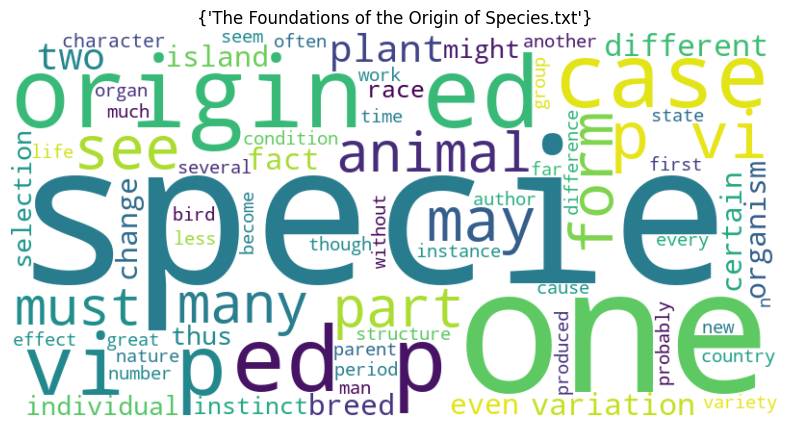

Top 20 termes pour le Livre The French Revolution.txt
        Term  Frequency
0        one       1291
1     return        891
2         de        835
3        men        690
4        man        675
5        day        650
6      paris        630
7      shall        626
8        may        624
9       king        555
10  national        547
11       say        546
12     thing        532
13    france        518
14       yet        489
15      like        487
16      even        465
17       new        459
18       two        430
19       old        428


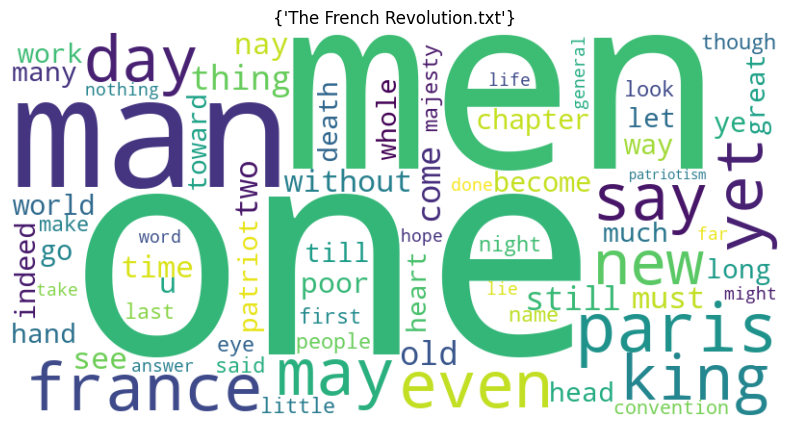

Top 20 termes pour le Livre The Gases of the Atmosphere The History of Their Discovery by William Ramsay.txt
          Term  Frequency
0          air        656
1          gas        219
2         acid        194
3       weight        193
4          one        183
5       oxygen        183
6   experiment        156
7        water        149
8        argon        143
9     nitrogen        143
10    hydrogen        133
11        work        129
12      volume        110
13        heat         99
14    molecule         99
15         two         98
16  phlogiston         96
17        made         93
18        must         92
19        part         91


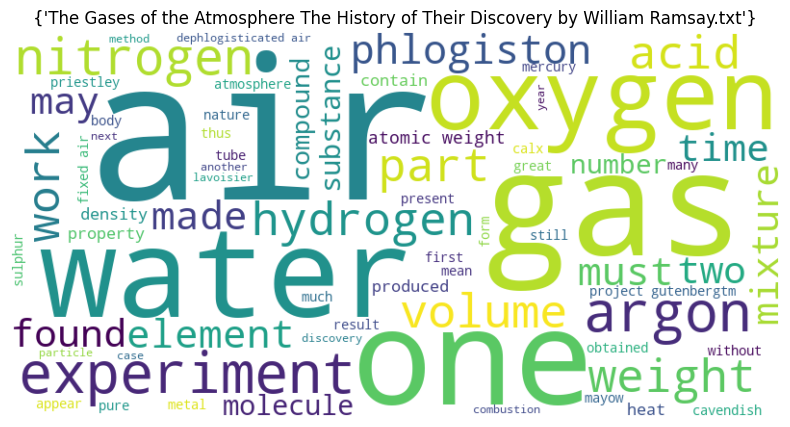

Top 20 termes pour le Livre The Greater Republic.txt
          Term  Frequency
0        state        800
1          one        747
2      general        735
3          new        600
4          war        583
5          men        563
6         made        536
7         time        477
8         year        468
9      country        467
10    american        464
11       would        437
12        upon        427
13      united        419
14        army        392
15         two        379
16   president        378
17       great        377
18  washington        373
19       could        373


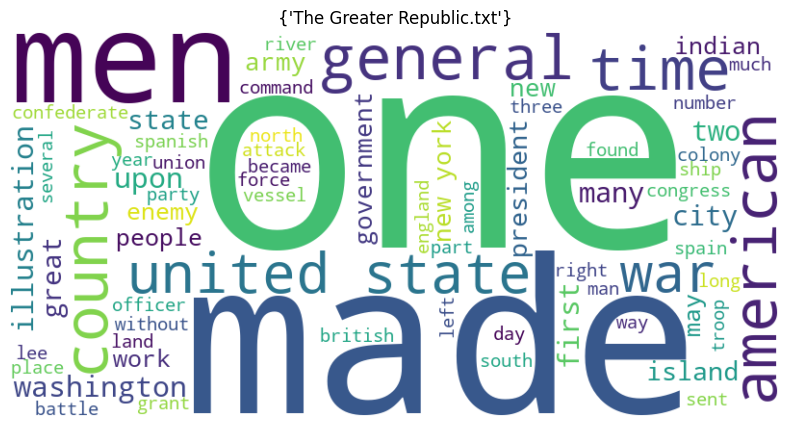

Top 20 termes pour le Livre The Handbook of Soap Manufacture.txt
              Term  Frequency
0             soap        862
1              oil        785
2             acid        576
3              per        357
4             cent        352
5                c        304
6         solution        290
7              fat        232
8              may        216
9            water        211
10           fatty        194
11            soda        171
12         alcohol        158
13         caustic        153
14          alkali        142
15  saponification        140
16              cc        135
17           added        126
18            used        121
19             use        115


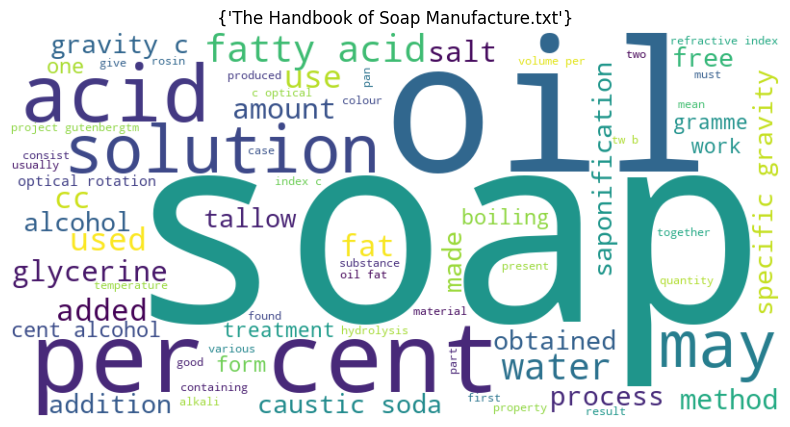

Top 20 termes pour le Livre The History of England from the Accession of James II.txt
          Term  Frequency
0        would        695
1        great        601
2         king        532
3        could        488
4          one        475
5     footnote        473
6         time        448
7        house        425
8      england        397
9          men        394
10        year        366
11        many        364
12       might        353
13        even        347
14        made        336
15  parliament        328
16     without        308
17  government        307
18     english        306
19     country        295


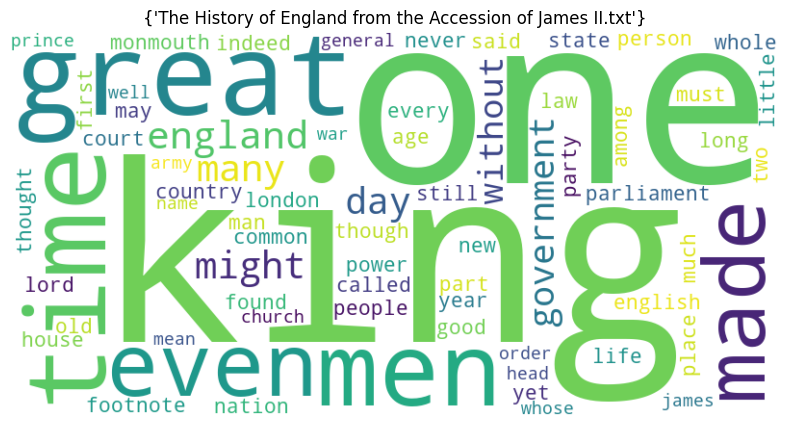

Top 20 termes pour le Livre The History Of The Decline And Fall Of The Roman Empire.txt
       Term  Frequency
0         p       9494
1    return       8820
2         c       4418
3         l       3902
4       tom       3278
5     roman       3130
6        de       3020
7   emperor       2918
8     might       2520
9        ii       2460
10      see       2312
11     year       2205
12      two       2199
13    first       2142
14      may       2096
15     city       1967
16     name       1940
17   empire       1820
18    could       1786
19    would       1778


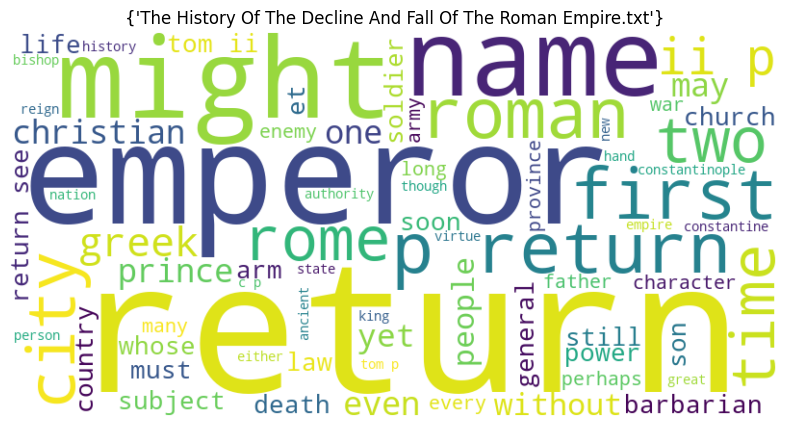

Top 20 termes pour le Livre The Last Leaf.txt
     Term  Frequency
0     one        262
1    time        202
2     men        180
3   great        177
4     man        177
5     day        169
6    year        163
7     old        160
8    came        140
9   could        139
10   work        134
11   well        125
12   upon        123
13   good        118
14  among        114
15   said        112
16  would        108
17   much        102
18   last        101
19  might        101


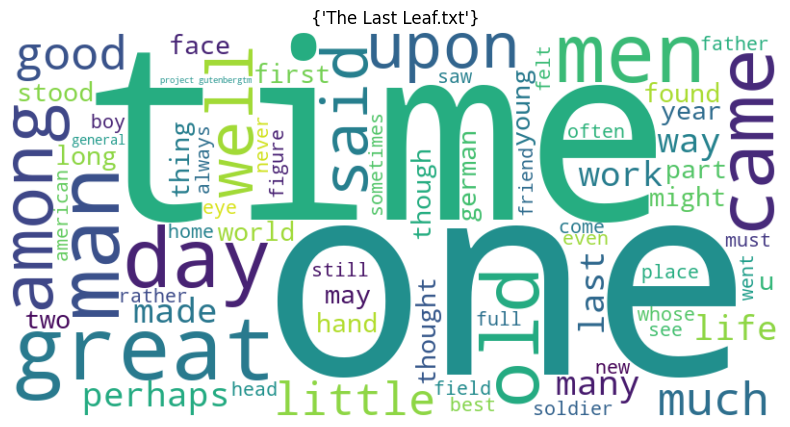

Top 20 termes pour le Livre The Magic Fishbone.txt
           Term  Frequency
0       project         88
1          work         78
2   gutenbergtm         56
3      princess         44
4          said         39
5          king         35
6        alicia         33
7     gutenberg         31
8    electronic         27
9    foundation         25
10         papa         22
11     fishbone         21
12         copy         21
13         term         21
14        fairy         21
15        state         21
16       prince         21
17        queen         19
18          old         18
19      duchess         18


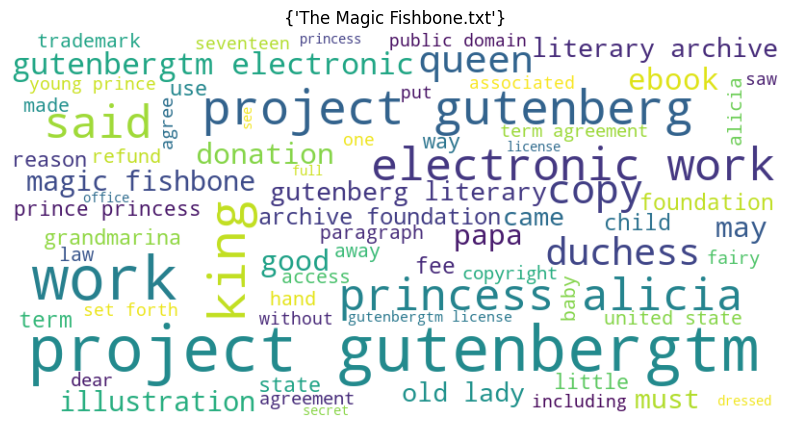

Top 20 termes pour le Livre The Magic of Oz.txt
       Term  Frequency
0      said        269
1    wizard        212
2        oz        197
3     magic        191
4     beast        154
5   dorothy        152
6      kiki        143
7       cat        140
8       one        138
9      trot        133
10     capn        126
11    glass        125
12    could        124
13    would        122
14   forest        118
15        u        116
16     bill        113
17   people        112
18     ozma        109
19    asked        103


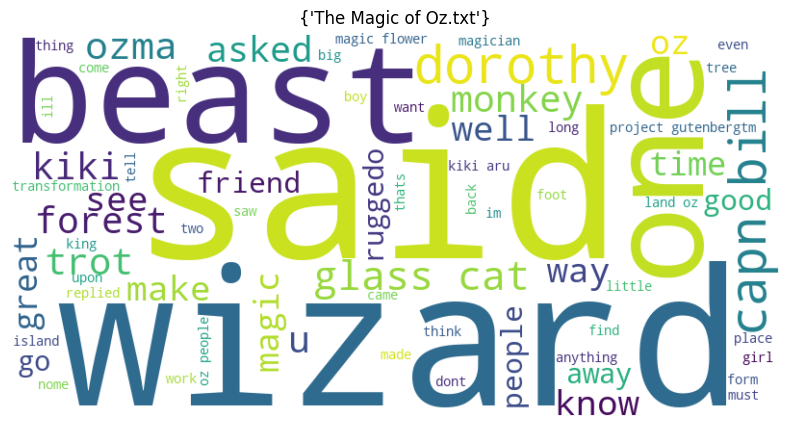

Top 20 termes pour le Livre The Natural Food of Man.txt
         Term  Frequency
0        food        878
1        diet        436
2      animal        407
3        upon        312
4        meat        283
5         man        278
6       would        271
7         one        255
8       fruit        246
9        fact        212
10      value        211
11       body        201
12        may        182
13        per        180
14  vegetable        169
15       cent        163
16       must        158
17        eat        149
18       many        141
19     system        137


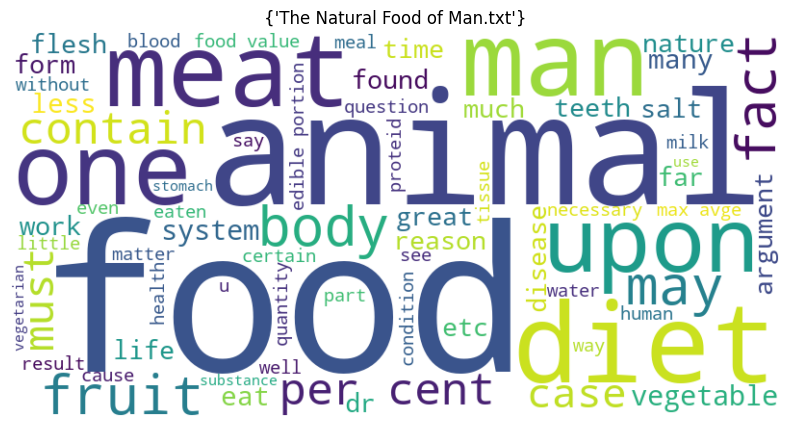

Top 20 termes pour le Livre The Phase Rule and Its Applications.txt
           Term  Frequency
0         point       1323
1   temperature       1155
2      solution        954
3         curve        917
4         phase        816
5        system        801
6      pressure        709
7           two        708
8          case        646
9          salt        599
10        solid        592
11       liquid        517
12        water        486
13       vapour        486
14  equilibrium        468
15    component        461
16          one        439
17    therefore        426
18  composition        420
19          fig        415


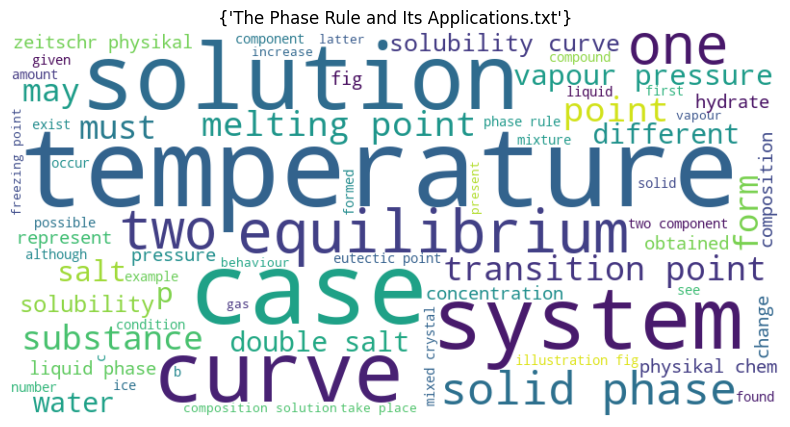

Top 20 termes pour le Livre The Princess and the Goblin.txt
           Term  Frequency
0          said        331
1        curdie        298
2      princess        290
3         could        198
4           one        184
5         would        179
6         irene        172
7        goblin        169
8          king        158
9           see        144
10       little        138
11         like        126
12         must        126
13         came        125
14         know        118
15         time        115
16         work        115
17         hand        113
18  grandmother        113
19         upon        109


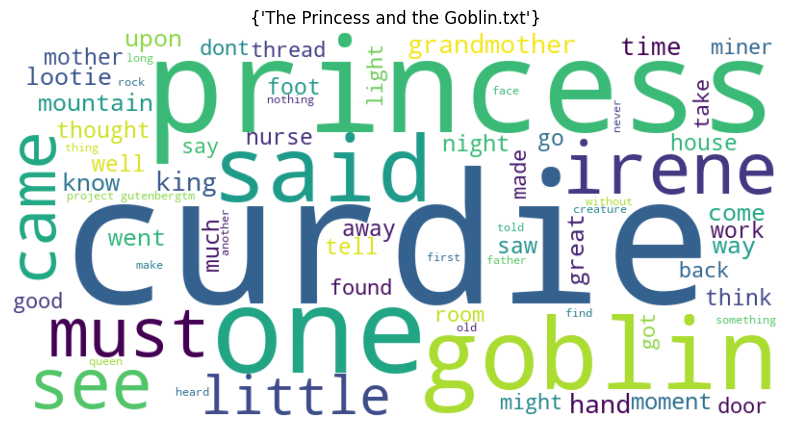

Top 20 termes pour le Livre The Progress of Invention in the Nineteenth.txt
            Term  Frequency
0            fig        623
1        machine        587
2         patent        515
3   illustration        395
4          first        394
5           made        389
6            one        364
7       electric        357
8          steam        341
9          great        318
10         state        289
11          work        279
12           may        266
13          year        260
14           gas        250
15         water        249
16        united        247
17          form        242
18       century        230
19           air        214


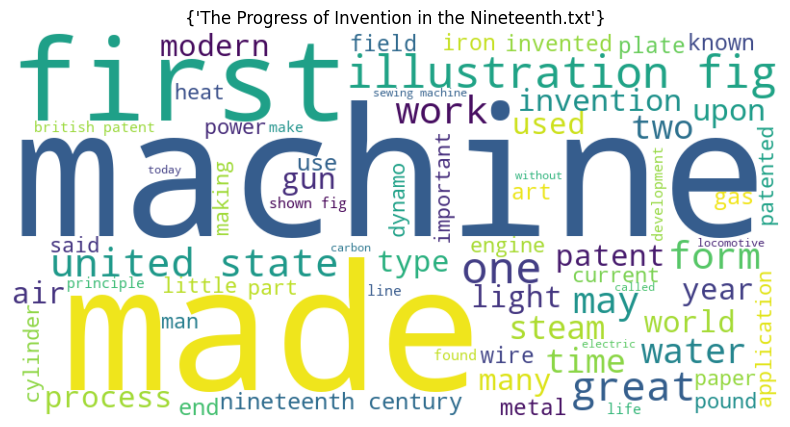

Top 20 termes pour le Livre The Railway Children.txt
       Term  Frequency
0      said       1141
1     peter        542
2    bobbie        466
3    mother        439
4   phyllis        279
5      like        227
6      dont        214
7      know        189
8       one        179
9    little        173
10    child        166
11      say        155
12    thing        153
13       oh        148
14      see        143
15    would        140
16       go        139
17    think        138
18     come        138
19     well        137


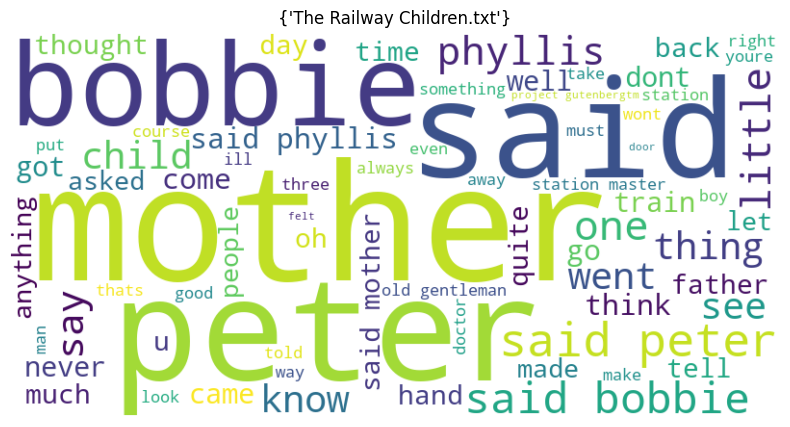

Top 20 termes pour le Livre The Rose and the Ring.txt
          Term  Frequency
0       giglio        218
1         king        188
2       prince        176
3          say        175
4         said        125
5        bulbo        120
6     angelica        120
7       little        113
8        royal        106
9     princess        105
10     majesty         91
11     project         87
12       queen         87
13        work         81
14    betsinda         75
15        came         72
16  gruffanuff         68
17       fairy         65
18        poor         65
19       young         62


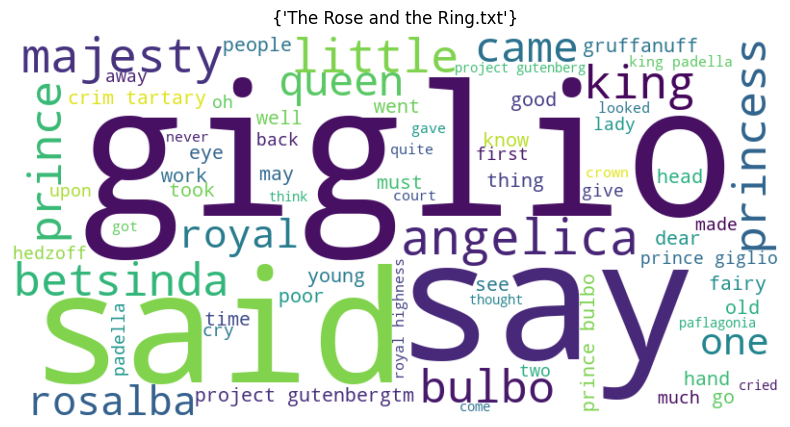

Top 20 termes pour le Livre The Ruins.txt
       Term  Frequency
0       god        322
1       one        288
2       man        283
3       law        242
4    nature        228
5       men        227
6    nation        204
7     every        194
8     first        192
9    people        173
10        u        169
11    world        164
12     said        164
13        q        162
14    state        153
15      say        145
16     work        140
17  without        139
18     idea        137
19     name        131


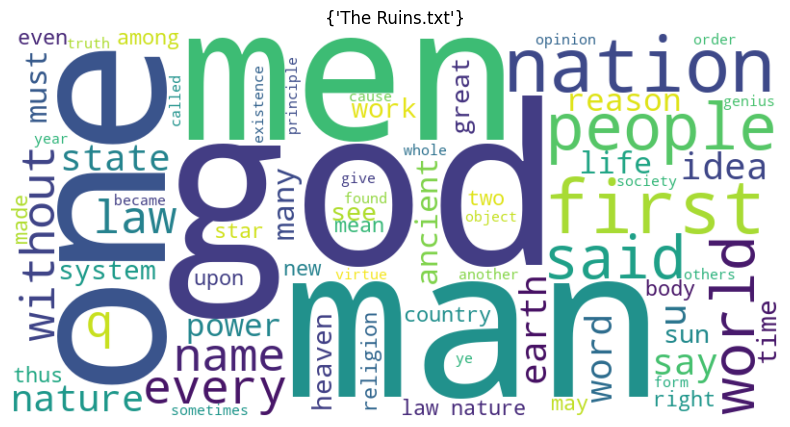

Top 20 termes pour le Livre The Secret Garden.txt
      Term  Frequency
0     said        831
1     mary        691
2      one        453
3       th        371
4     like        363
5    colin        302
6    thing        295
7   dickon        279
8   garden        260
9    could        235
10   would        231
11  looked        224
12      mr        224
13     tha        223
14  little        222
15    know        222
16     see        213
17    look        192
18    come        191
19   never        184


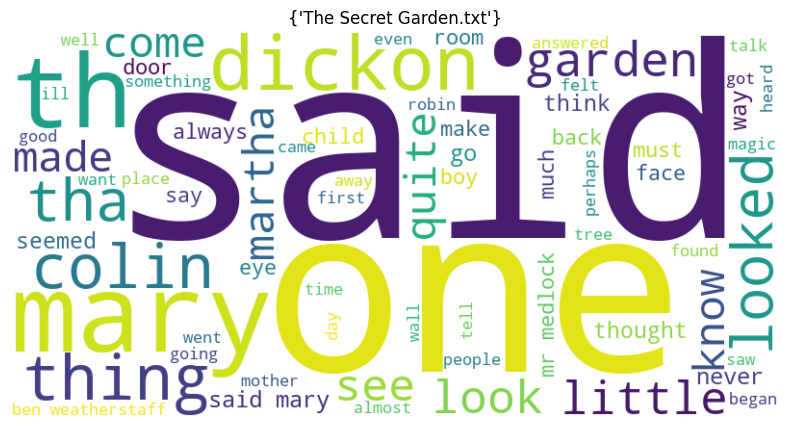

Top 20 termes pour le Livre The Tale of Timmy Tiptoes.txt
            Term  Frequency
0        project         87
1           work         79
2    gutenbergtm         56
3         tiptoe         33
4          timmy         31
5      gutenberg         30
6   illustration         28
7     electronic         27
8     foundation         25
9           term         21
10         state         20
11          copy         19
12           nut         19
13        little         18
14     agreement         18
15         goody         17
16          full         16
17      donation         16
18           may         15
19       license         15


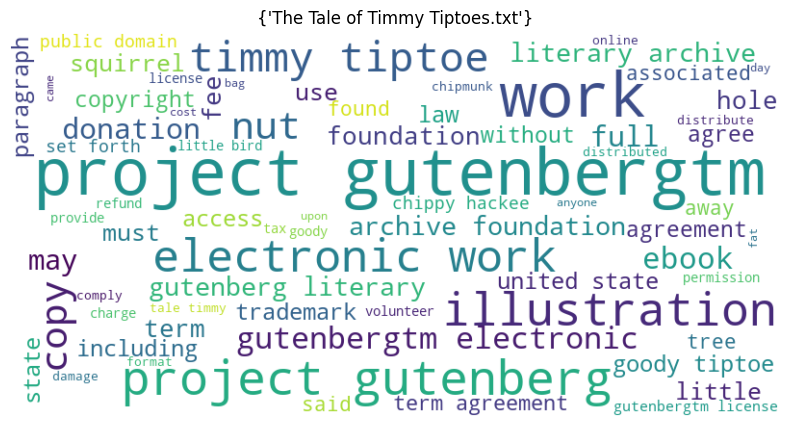

Top 20 termes pour le Livre The Threefold Commonwealth.txt
          Term  Frequency
0         life        568
1       social        404
2          one        306
3     economic        280
4    spiritual        228
5         must        181
6         work        172
7        state        163
8        right        162
9         body        149
10       human        135
11      people        133
12         man        124
13         may        121
14        form        114
15     thought        113
16         way        111
17  individual         92
18   commodity         91
19     project         90


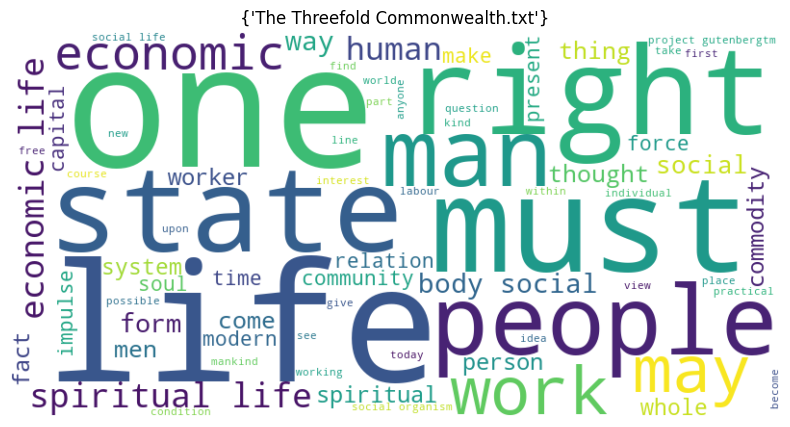

Top 20 termes pour le Livre The Toxicity of Caffein An experimental study on different species of animals.txt
          Term  Frequency
0      caffein       1071
1          per        803
2         gram        689
3         kilo        553
4            p        545
5       rabbit        518
6           cc        422
7       weight        375
8      symptom        350
9         cent        313
10  experiment        304
11         may        303
12    injected        289
13          mg        267
14        diet        258
15        hour        251
16         aug        215
17       given        203
18        dose        202
19       found        197


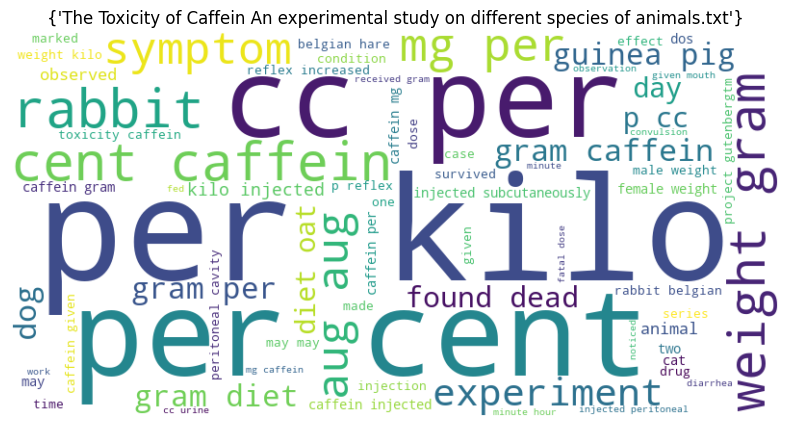

Top 20 termes pour le Livre The United States of America Part I.txt
            Term  Frequency
0          state       1201
1     government        463
2            new        442
3          would        419
4       national        403
5       congress        348
6         people        326
7            war        301
8            one        295
9          power        278
10         could        274
11        united        270
12          year        265
13          time        265
14      american        242
15  constitution        227
16          upon        219
17         first        206
18          made        203
19     jefferson        189


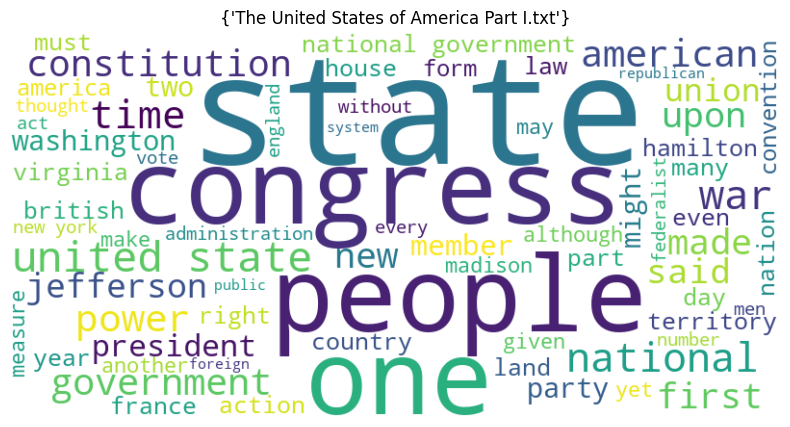

Top 20 termes pour le Livre The White Feather.txt
        Term  Frequency
0      sheen        479
1       said        426
2        one        197
3      would        191
4     school        168
5      house        142
6     linton        130
7   drummond        129
8       time        125
9         mr        117
10      work        114
11       got        111
12      good        109
13     thing        109
14  stanning        102
15      like        101
16      dont        100
17       sir         97
18     could         97
19       get         96


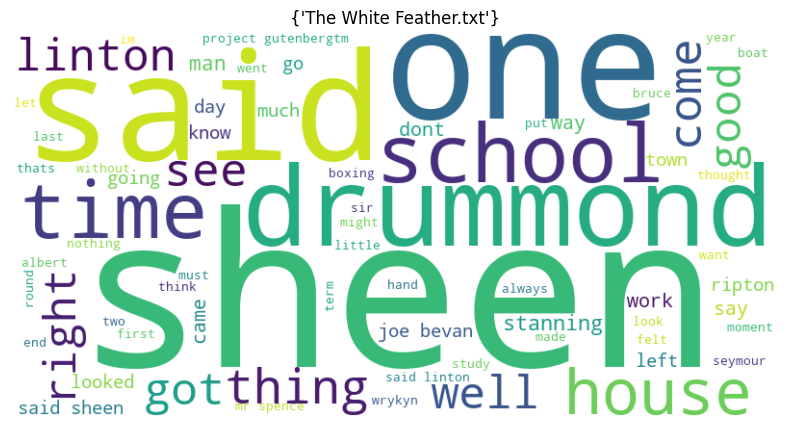

Top 20 termes pour le Livre Three Minute Stories.txt
            Term  Frequency
0           said        264
1         little        167
2            one        113
3        project         88
4            cat         88
5            dog         81
6           work         81
7           time         77
8   illustration         76
9            old         71
10           say         68
11        johnny         62
12           see         58
13   gutenbergtm         56
14           boy         48
15           day         46
16            mr         46
17            oh         46
18          know         45
19         great         42


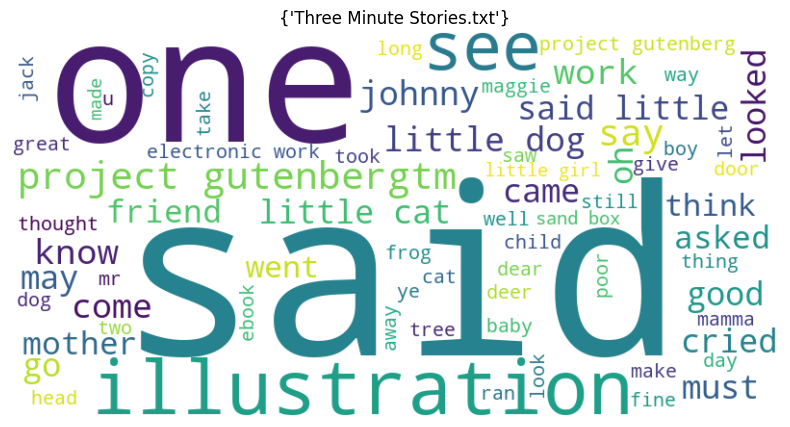

Top 20 termes pour le Livre Through the Looking-Glass.txt
       Term  Frequency
0      said        470
1     alice        428
2     queen        195
3       one        150
4      know        125
5      like        123
6    little        115
7   thought         91
8     would         88
9      went         88
10  project         87
11      see         85
12     work         85
13     time         81
14    thing         79
15     dont         78
16      way         74
17    could         72
18     hand         69
19       go         69


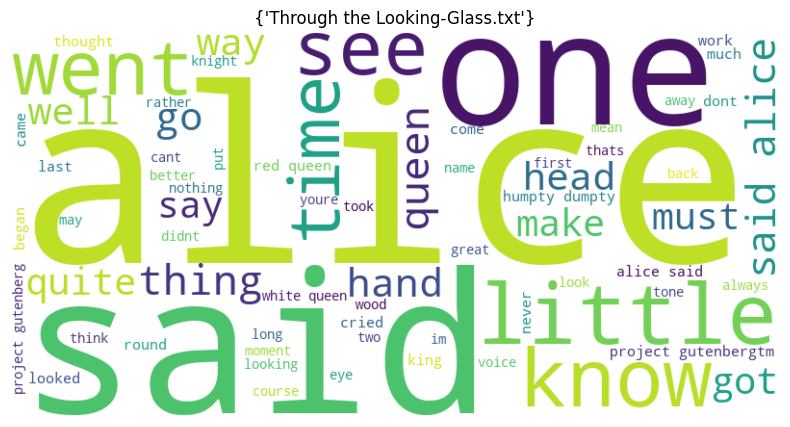

Top 20 termes pour le Livre Tiger and Tom and Other Stories for Boys.txt
            Term  Frequency
0            boy        294
1           said        222
2            one        155
3             mr        154
4         father        143
5          would        130
6            man        129
7           work        120
8         mother        118
9            old        115
10  illustration        114
11          hand        102
12          time         97
13         could         96
14            go         93
15        little         91
16          much         89
17       project         88
18           day         86
19          home         82


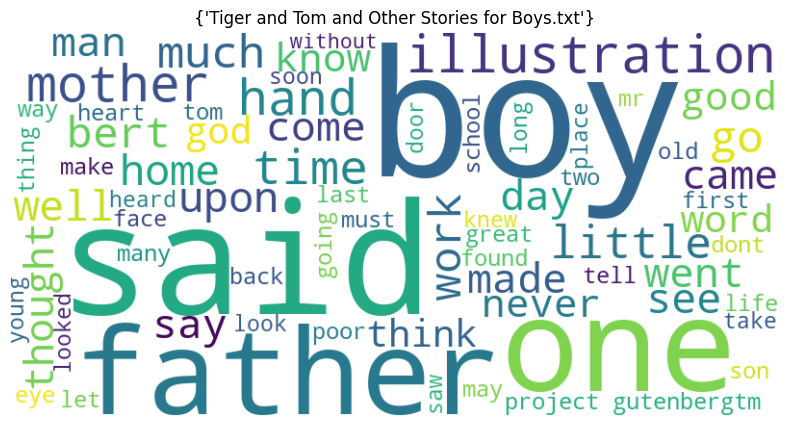

Top 20 termes pour le Livre Tom Sawyer Abroad.txt
       Term  Frequency
0       tom        296
1       see        234
2       say        192
3       got        163
4       jim        149
5      said        137
6      aint        136
7      like        134
8      dont        130
9       way        128
10     know        126
11     come        126
12    could        126
13    thing        117
14  couldnt        107
15       de        107
16     well        105
17     time        104
18      one        103
19       go         97


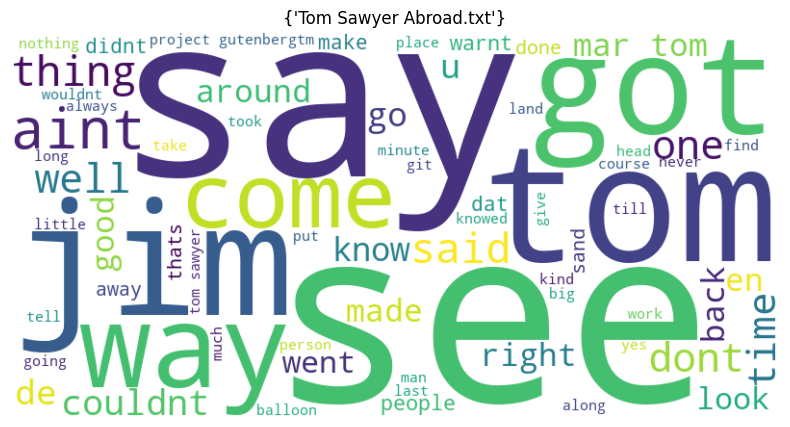

Top 20 termes pour le Livre War and Peace.txt
        Term  Frequency
0       said       2834
1        one       2164
2     pierre       1951
3     prince       1929
4      would       1362
5        man       1169
6     andrew       1135
7      could       1111
8     natsha       1092
9       time       1072
10      face       1047
11  princess        934
12      know        926
13   thought        879
14       eye        874
15    french        872
16      went        859
17      room        817
18       old        803
19      hand        796


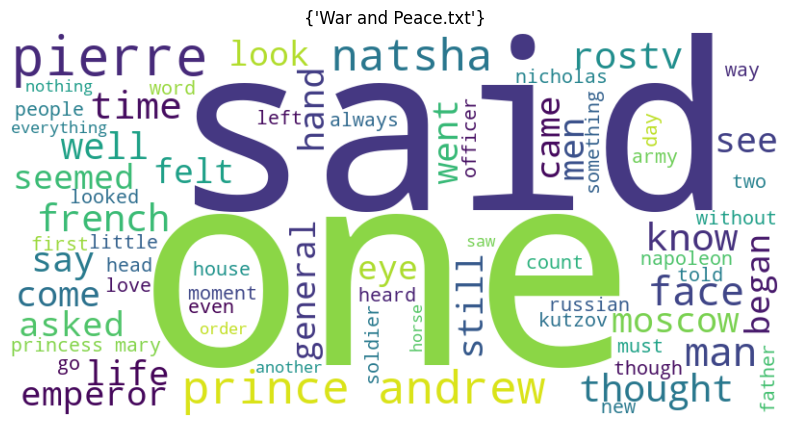

In [9]:
def word_cloud(text, title):
    wordcloud = WordCloud(width=800, height=400, background_color='white' ,max_words=70).generate(' '.join(text))
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title)
    plt.axis('off')
    plt.show()
    plt.close()

# word cloud pour chaque fichier
for i, (tokens, book_freq) in enumerate(zip(lemmatized_books, term_freq)):
    filename = os.listdir(books_folder)[i]
    print(f'Top 20 termes pour le Livre {filename}')
    top_20 = book_freq.most_common(20)
    df_20_terms = pd.DataFrame(top_20, columns=['Term', 'Frequency'])
    print(df_20_terms)

    word_cloud(tokens, {filename})

# **TOPIC MODELING**

Le TF-IDF (Term Frequency-Inverse Document Frequency) est particulièrement utile et pertinent lorsqu'on travaille avec plusieurs documents, voire un corpus entier.


In [11]:
vectorizer = TfidfVectorizer()

tfidf_matrix = vectorizer.fit_transform([" ".join(book) for book in lemmatized_books])
termss = vectorizer.get_feature_names_out()

df_tfidf = pd.DataFrame(tfidf_matrix.toarray(), columns=termss, index=os.listdir(books_folder))

for filename in df_tfidf.index:
    print(f'Top 20 termes pour le Livre {filename}:')
    top_20 = df_tfidf.loc[filename].nlargest(20)
    print(top_20.to_frame(name='TF-IDF'))
    print('\n')

Top 20 termes pour le Livre The History Of The Decline And Fall Of The Roman Empire.txt:
                  TF-IDF
return          0.295456
tom             0.228392
roman           0.197040
emperor         0.193010
de              0.140293
hist            0.121674
empire          0.111862
rome            0.100382
christian       0.098401
constantine     0.098374
ii              0.095890
barbarian       0.092834
constantinople  0.091292
might           0.087663
greek           0.086991
province        0.086909
reign           0.080767
julian          0.079311
see             0.077448
year            0.073864


Top 20 termes pour le Livre Experiments and Observations on Different.txt:
               TF-IDF
air          0.672028
nitrous      0.252783
water        0.198458
inflammable  0.198311
phlogiston   0.171233
acid         0.139627
quantity     0.136942
phial        0.123783
common       0.118314
experiment   0.115154
fixed        0.110715
quicksilver  0.105821
made         0.089315
d

In [12]:
for i, book in enumerate(lemmatized_books):
      filename = os.listdir(books_folder)[i]
      print("*****************************************************************************************\n")
      print(f'Top 20 termes pour le Livre {filename}')

      book_freq = Counter(book)
      top_20 = book_freq.most_common(20)
      df_top_20 = pd.DataFrame(top_20, columns=['Term', 'Frequency'])

      vectorizer = TfidfVectorizer()
      tfidf_matrix = vectorizer.fit_transform([" ".join(book)])
      terms = vectorizer.get_feature_names_out()
      df_tfidf = pd.DataFrame(tfidf_matrix.toarray(), columns=terms)

      tfidf_scores = df_tfidf.iloc[0]
      tfidf_dict = tfidf_scores.to_dict()
      df_top_20['TF-IDF'] = df_top_20['Term'].map(tfidf_dict)

      print(df_top_20)

*****************************************************************************************

Top 20 termes pour le Livre The History Of The Decline And Fall Of The Roman Empire.txt
       Term  Frequency    TF-IDF
0         p       9494       NaN
1    return       8820  0.441417
2         c       4418       NaN
3         l       3902       NaN
4       tom       3278  0.164055
5     roman       3130  0.156648
6        de       3020  0.151143
7   emperor       2918  0.146038
8     might       2520  0.126119
9        ii       2460  0.123116
10      see       2312  0.115709
11     year       2205  0.110354
12      two       2199  0.110054
13    first       2142  0.107201
14      may       2096  0.104899
15     city       1967  0.098443
16     name       1940  0.097092
17   empire       1820  0.091086
18    could       1786  0.089384
19    would       1778  0.088984
*****************************************************************************************

Top 20 termes pour le Livre Experimen

In [13]:
vectorizer = TfidfVectorizer()

X = vectorizer.fit_transform([" ".join(book) for book in lemmatized_books])
termss = vectorizer.get_feature_names_out()

df_tfidf_matrixs = pd.DataFrame(X.toarray(), columns=termss, index=os.listdir(books_folder))

df_tfidf_matrixs

,aa,aaa,aaah,aadido,aadites,aah,aanhydrous,aant,aar,aarhundrede,...,zwolftafelfragmente,zygoma,zygomala,zygomalas,zygomatic,zymase,zymotechnia,zymotic,zythus,zz
The History Of The Decline And Fall Of The Roman Empire.txt,0.000093,0.000000,0.000000,0.00000,0.000143,0.000000,0.00000,0.000000,0.000130,0.00000,...,0.000143,0.000000,0.000143,0.000143,0.000000,0.000000,0.000000,0.000000,0.000143,0.00000
Experiments and Observations on Different.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
alice-in-wonderland.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Threefold Commonwealth.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Rose and the Ring.txt,0.001854,0.000000,0.002859,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Magic of Oz.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Greater Republic.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Princess and the Goblin.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
The Complete Herbal.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
Mother Storie.txt,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000


# **LATENT SEMANTIC ANALYSIS (L.S.A)**

#### **1. LSA with TruncatedSVD**

In [14]:
from sklearn.decomposition import TruncatedSVD

lsa = TruncatedSVD(n_components=3, random_state=42)
lsa_topic_matrix = lsa.fit_transform(X)

In [15]:
feature_names = vectorizer.get_feature_names_out()
df_topic_components = pd.DataFrame(lsa.components_, columns=feature_names)

#chaque sujet
for i in range(lsa.n_components):
    top_features = df_topic_components.iloc[i].nlargest(10)
    print(f"Topic {i + 1}: {top_features.index.tolist()}")

Topic 1: ['one', 'said', 'work', 'would', 'project', 'time', 'little', 'state', 'could', 'may']
Topic 2: ['said', 'alice', 'little', 'mr', 'mother', 'boy', 'dont', 'know', 'project', 'queen']
Topic 3: ['acid', 'air', 'solution', 'water', 'oil', 'cc', 'soap', 'temperature', 'work', 'project']


In [16]:
!pip install pyLDAvis

from gensim.corpora import Dictionary
from gensim.models import LdaModel
import pyLDAvis
import pyLDAvis.gensim


#dictionnaire
dictionary = Dictionary(lemmatized_books)

#Bag-of-Words
bow_corpus = [dictionary.doc2bow(book) for book in lemmatized_books]

# Entrainement votre modèle LDA
lda_model_final = LdaModel(bow_corpus, num_topics=3, id2word=dictionary, passes=15)



vis = pyLDAvis.gensim.prepare(lda_model_final, bow_corpus, dictionary)
pyLDAvis.display(vis)

In [17]:
topic_weights_df = pd.DataFrame(lsa_topic_matrix, index=os.listdir(books_folder), columns=[f"Topic {i+1}" for i in range(lsa.n_components)])
topic_weights_df

,Topic 1,Topic 2,Topic 3
The History Of The Decline And Fall Of The Roman Empire.txt,0.482594,-0.263510,-0.205300
Experiments and Observations on Different.txt,0.314770,-0.209662,0.388167
alice-in-wonderland.txt,0.275822,0.265384,0.062788
The Threefold Commonwealth.txt,0.394231,-0.153742,-0.014089
The Rose and the Ring.txt,0.340959,0.176735,-0.020214
The Magic of Oz.txt,0.338231,0.187035,0.024931
The Greater Republic.txt,0.618125,-0.346293,-0.275962
The Princess and the Goblin.txt,0.439323,0.275227,0.010495
The Complete Herbal.txt,0.296928,-0.060747,0.137337
Mother Storie.txt,0.616066,0.385349,0.038193


In [18]:
#matrice de similarité pour les books
similarity_matrix = cosine_similarity(topic_weights_df)
similarity_df = pd.DataFrame(similarity_matrix, index=topic_weights_df.index, columns=topic_weights_df.index)
similarity_df


,The History Of The Decline And Fall Of The Roman Empire.txt,Experiments and Observations on Different.txt,alice-in-wonderland.txt,The Threefold Commonwealth.txt,The Rose and the Ring.txt,The Magic of Oz.txt,The Greater Republic.txt,The Princess and the Goblin.txt,The Complete Herbal.txt,Mother Storie.txt,...,The History of England from the Accession of James II.txt,The Railway Children.txt,The United States of America Part I.txt,The Eighteenth Brumaire of Louis Bonaparte.txt,Prince Prigio.txt,The fauna of the deep sea.txt,Three Minute Stories.txt,Sandman_s Goodnight Stories.txt,The Progress of Invention in the Nineteenth.txt,Narrative and Critical History of America.txt
The History Of The Decline And Fall Of The Roman Empire.txt,1.000000,0.400719,0.220898,0.940296,0.541048,0.478732,0.999849,0.451264,0.671330,0.440021,...,0.990535,0.288733,0.989513,0.997750,0.522451,0.716902,0.402570,0.349600,0.718221,0.981167
Experiments and Observations on Different.txt,0.400719,1.000000,0.264267,0.657462,0.299503,0.366500,0.388400,0.301248,0.884542,0.324454,...,0.418932,0.205794,0.330129,0.408754,0.363266,0.919776,0.342516,0.287185,0.924647,0.562962
alice-in-wonderland.txt,0.220898,0.264267,1.000000,0.408305,0.936381,0.961837,0.207728,0.968934,0.576468,0.972878,...,0.352644,0.993321,0.085194,0.158845,0.947014,0.383830,0.981528,0.990677,0.322346,0.200189
The Threefold Commonwealth.txt,0.940296,0.657462,0.408305,1.000000,0.660413,0.635664,0.934417,0.595503,0.883479,0.594294,...,0.958799,0.442873,0.889705,0.931331,0.666711,0.900013,0.571686,0.514817,0.892982,0.971277
The Rose and the Ring.txt,0.541048,0.299503,0.936381,0.660413,1.000000,0.992802,0.530517,0.994040,0.685566,0.991233,...,0.651093,0.961383,0.424356,0.485252,0.996806,0.531544,0.982971,0.975427,0.477875,0.502032
The Magic of Oz.txt,0.478732,0.366500,0.961837,0.635664,0.992802,1.000000,0.466636,0.997541,0.717704,0.998486,...,0.594598,0.973146,0.352810,0.422669,0.998566,0.558198,0.996399,0.989030,0.503553,0.458353
The Greater Republic.txt,0.999849,0.388400,0.207728,0.934417,0.530517,0.466636,1.000000,0.439682,0.658780,0.428028,...,0.988571,0.276847,0.991715,0.998203,0.510885,0.706482,0.389984,0.337197,0.708462,0.979142
The Princess and the Goblin.txt,0.451264,0.301248,0.968934,0.595503,0.994040,0.997541,0.439682,1.000000,0.667515,0.999479,...,0.569435,0.983816,0.326716,0.392986,0.995708,0.500129,0.996552,0.993593,0.443486,0.419034
The Complete Herbal.txt,0.671330,0.884542,0.576468,0.883479,0.685566,0.717704,0.658780,0.667515,1.000000,0.680492,...,0.723411,0.557979,0.576499,0.655612,0.725247,0.975528,0.682872,0.631465,0.959079,0.766136
Mother Storie.txt,0.440021,0.324454,0.972878,0.594294,0.991233,0.998486,0.428028,0.999479,0.680492,1.000000,...,0.559113,0.984167,0.313318,0.382019,0.995461,0.513013,0.998593,0.995122,0.456456,0.413572


In [19]:
#captured variance
total_variance = np.sum(topic_weights_df.var())
topic_variances = {}

for col in topic_weights_df.columns:
  topic_variances[col] = topic_weights_df[col].var()

captured_variances = {}
for topic, variance in topic_variances.items():
  captured_variances[topic] = variance / total_variance

captured_variances

{'Topic 1': 0.1802679815585491,
 'Topic 2': 0.4738030593076264,
 'Topic 3': 0.3459289591338245}

la variance capturé représente la proportion de la variance totale des données expliquée par chaque topic dans le topic modeling.

- **pour une combinaison aléatoire entre chaque topic 2*2, aucune combinaison ne suffit pour représentrer l'enssemble des documents.**

In [20]:
print("Poids moyens des topics:")
print(topic_weights_df.mean())
print('****************************************')

print("\nDocuments avec les poids les plus élevés pour le topic 1:")
print(topic_weights_df["Topic 1"].nlargest(10))
print('****************************************')

print("\nDocuments avec les poids les plus élevés pour le topic 2:")
print(topic_weights_df["Topic 2"].nlargest(10))
print('****************************************')

print("\nDocuments avec les poids les plus élevés pour le topic 3:")
print(topic_weights_df["Topic 3"].nlargest(10))
print('****************************************')

Poids moyens des topics:
Topic 1    0.420198
Topic 2   -0.011616
Topic 3    0.042776
dtype: float64
****************************************

Documents avec les poids les plus élevés pour le topic 1:
The Last Leaf.txt                                            0.738398
Tiger and Tom and Other Stories for Boys.txt                 0.683292
The History of England from the Accession of James II.txt    0.673436
Curious Myths of the Middle Ages.txt                         0.642300
The Greater Republic.txt                                     0.618125
Mother Storie.txt                                            0.616066
The Ruins.txt                                                0.615576
Among the Forest People.txt                                  0.615248
Three Minute Stories.txt                                     0.607632
The French Revolution.txt                                    0.595222
Name: Topic 1, dtype: float64
****************************************

Documents avec les poids les

- **Topic 2:** Bien qu'il ne soit pas très présent en moyenne(-0.011616), il est le plus important pour différencier les documents (var = 47.38%). Il représente probablement un sujet spécifique qui n'est pas abordé par tous les documents.
- **Topic 1:** Il est le plus fréquent (moy=0.420198), mais il est moins utile pour distinguer les documents (var =0.1802). Il représente un sujet général qui est partagé par beaucoup de documents.
- **Topic 3:** Il a une importance et une fréquence moyennes. Il représente un sujet qui est présent dans certains documents et qui aide à les distinguer, mais moins que le Topic 2.


In [21]:
#add all book from topic based weight max values
topic_list = {}

for i, j in topic_weights_df.iterrows():
    max = j.idxmax()

    if max not in topic_list:
        topic_list[max] = []
    topic_list[max].append(i)

for topic, books in topic_list.items():
    print(f"livre du {topic}: {books}")


livre du Topic 1: ['The History Of The Decline And Fall Of The Roman Empire.txt', 'alice-in-wonderland.txt', 'The Threefold Commonwealth.txt', 'The Rose and the Ring.txt', 'The Magic of Oz.txt', 'The Greater Republic.txt', 'The Princess and the Goblin.txt', 'The Complete Herbal.txt', 'Mother Storie.txt', 'How the Flag Became Old Glory.txt', 'The Tale of Timmy Tiptoes.txt', 'Peter-pan.txt', 'The French Revolution.txt', 'The Natural Food of Man.txt', 'Curious Myths of the Middle Ages.txt', 'The Secret Garden.txt', 'History of King Charles The First of England.txt', 'Tiger and Tom and Other Stories for Boys.txt', 'Democracy In America, Volume 1 (of 2).txt', 'Little Lord Fauntleroy.txt', 'The White Feather.txt', 'Among the Forest People.txt', 'Medieval People.txt', 'The Ruins.txt', 'The Foundations of the Origin of Species.txt', 'Tom Sawyer Abroad.txt', 'The Last Leaf.txt', 'Through the Looking-Glass.txt', 'War and Peace.txt', 'The Magic Fishbone.txt', 'Formation of the Union, 1750-1829.tx

In [22]:
#afficher les index du topic_weights_df
print(topic_weights_df.index)

Index(['The History Of The Decline And Fall Of The Roman Empire.txt',
       'Experiments and Observations on Different.txt',
       'alice-in-wonderland.txt', 'The Threefold Commonwealth.txt',
       'The Rose and the Ring.txt', 'The Magic of Oz.txt',
       'The Greater Republic.txt', 'The Princess and the Goblin.txt',
       'The Complete Herbal.txt', 'Mother Storie.txt',
       'An Introductory Course of Quantitative Chemical Analysis.txt',
       'How the Flag Became Old Glory.txt', 'The Tale of Timmy Tiptoes.txt',
       'Peter-pan.txt', 'The French Revolution.txt',
       'The Natural Food of Man.txt', 'The Elements of Blowpipe Analysis.txt',
       'Curious Myths of the Middle Ages.txt', 'The Secret Garden.txt',
       'History of King Charles The First of England.txt',
       'Tiger and Tom and Other Stories for Boys.txt',
       'Democracy In America, Volume 1 (of 2).txt',
       'Little Lord Fauntleroy.txt', 'The Handbook of Soap Manufacture.txt',
       'The Chemistry of Co

In [23]:
#afficher les similarités
def best_recommended_books(book_title):
  book_index = topic_weights_df.index.get_loc(book_title)
  matching = cosine_similarity(topic_weights_df.iloc[[book_index]], topic_weights_df)[0]

  match_book = topic_weights_df.index[:]
  recommendations_df = pd.DataFrame({'Livre': match_book})

  return recommendations_df

recommendations = best_recommended_books("Peter-pan.txt")
print(f"Livres similaires à Peter-pan.txt :\n{recommendations}")

Livres similaires à Peter-pan.txt :
                                                Livre
0   The History Of The Decline And Fall Of The Rom...
1       Experiments and Observations on Different.txt
2                             alice-in-wonderland.txt
3                      The Threefold Commonwealth.txt
4                           The Rose and the Ring.txt
5                                 The Magic of Oz.txt
6                            The Greater Republic.txt
7                     The Princess and the Goblin.txt
8                             The Complete Herbal.txt
9                                   Mother Storie.txt
10  An Introductory Course of Quantitative Chemica...
11                  How the Flag Became Old Glory.txt
12                      The Tale of Timmy Tiptoes.txt
13                                      Peter-pan.txt
14                          The French Revolution.txt
15                        The Natural Food of Man.txt
16              The Elements of Blowpipe Analy

In [24]:
#similarité/pourcentage
def best_recommended_books(book_title, number):
  book_index = topic_weights_df.index.get_loc(book_title)
  similarities = cosine_similarity(topic_weights_df.iloc[[book_index]], topic_weights_df)[0]

  recommendations_df = pd.DataFrame({'Livre': topic_weights_df.index, 'Similarité (%)': similarities * 100})
  recommendations_df = recommendations_df.sort_values(by=['Similarité (%)'], ascending=False)

  return recommendations_df

recommendations = best_recommended_books("alice-in-wonderland.txt", 10)
print(f"Livres similaires à Peter-pan.txt :\n{recommendations}")

Livres similaires à Peter-pan.txt :
                                                Livre  Similarité (%)
2                             alice-in-wonderland.txt      100.000000
34                      Through the Looking-Glass.txt       99.759227
43                           The Railway Children.txt       99.332141
49                    Sandman_s Goodnight Stories.txt       99.067742
18                              The Secret Garden.txt       98.389495
48                           Three Minute Stories.txt       98.152823
9                                   Mother Storie.txt       97.287836
7                     The Princess and the Goblin.txt       96.893438
27                        Among the Forest People.txt       96.708386
13                                      Peter-pan.txt       96.486950
22                         Little Lord Fauntleroy.txt       96.367736
5                                 The Magic of Oz.txt       96.183658
36                             The Magic Fishbone.txt 